In [1]:
import sys
print("python exe:", sys.executable)   # full path to the interpreter
print("python ver:", sys.version)

# try torch only in the working notebook
try:
    import torch
    print("torch      :", torch.__version__, torch.__file__)
except ModuleNotFoundError as e:
    print("torch not importable:", e)



python exe: c:\Users\aneek\anaconda3\envs\tf_gpu_env\python.exe
python ver: 3.9.23 | packaged by conda-forge | (main, Jun  4 2025, 17:49:16) [MSC v.1929 64 bit (AMD64)]
torch      : 1.12.1+cu113 c:\Users\aneek\anaconda3\envs\tf_gpu_env\lib\site-packages\torch\__init__.py


c:\Users\aneek\anaconda3\envs\tf_gpu_env\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import tensorflow as tf
print(tf.__version__)  # This should print the version of TensorFlow
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

print("CUDA version:", tf.sysconfig.get_build_info()["cuda_version"])
print("cuDNN version:", tf.sysconfig.get_build_info()["cudnn_version"])

from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

2.10.0
Num GPUs Available:  1
CUDA version: 64_112
cuDNN version: 64_8
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 4708791486312287889
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 5713690624
locality {
  bus_id: 1
  links {
  }
}
incarnation: 16573952611743557443
physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 4060 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.9"
xla_global_id: 416903419
]


In [3]:
import torch
print(torch.__version__)
print("CUDA Available: ", torch.cuda.is_available())


1.12.1+cu113
CUDA Available:  True


In [4]:
import tensorflow as tf
print("TensorFlow devices:")
print(tf.config.list_physical_devices())

# Force TensorFlow to use GPU
tf.config.experimental.set_memory_growth(tf.config.experimental.list_physical_devices('GPU')[0], True)

# Test a simple matrix multiplication
with tf.device('/GPU:0'):
    a = tf.constant([[1.0, 2.0], [3.0, 4.0]])
    b = tf.constant([[5.0, 6.0], [7.0, 8.0]])
    c = tf.matmul(a, b)
    print("TensorFlow running on GPU:", c)


TensorFlow devices:
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
TensorFlow running on GPU: tf.Tensor(
[[19. 22.]
 [43. 50.]], shape=(2, 2), dtype=float32)


In [5]:
import torch
print("Torch CUDA Version:", torch.version.cuda)
print("Torch cuDNN Version:", torch.backends.cudnn.version())
print("Available GPUs:", torch.cuda.device_count())
print("GPU Name:", torch.cuda.get_device_name(0))


Torch CUDA Version: 11.3
Torch cuDNN Version: 8302
Available GPUs: 1
GPU Name: NVIDIA GeForce RTX 4060 Laptop GPU


In [6]:
import torch
print(f"Allocated GPU memory: {torch.cuda.memory_allocated() / 1024**3:.2f} GB")
print(f"Reserved GPU memory: {torch.cuda.memory_reserved() / 1024**3:.2f} GB")


Allocated GPU memory: 0.00 GB
Reserved GPU memory: 0.00 GB


In [7]:
import tensorflow as tf
gpu_devices = tf.config.list_physical_devices('GPU')
if gpu_devices:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
import torch
torch.cuda.empty_cache()


In [4]:
import time
import tensorflow as tf
import psutil

class PowerMonitor:
    def __init__(self):
        self.gpu_available = tf.config.list_physical_devices('GPU')
        
        # Hardware power specifications (adjust these values for your system)
        self.cpu_tdp = 65    # Typical TDP for desktop CPUs in watts
        self.gpu_tdp = 250   # Typical TDP for desktop GPUs in watts
        
    def get_stats(self):
        """Get system stats with power estimation"""
        stats = {
            'timestamp': time.time(),
            'cpu_%': psutil.cpu_percent(interval=0.1),
            'ram_mb': psutil.virtual_memory().used / (1024**2),
            'gpu_mem_mb': 0,
            'power_w': self.cpu_tdp * (psutil.cpu_percent()/100) * 0.85  # Base CPU power
        }
        
        if self.gpu_available:
            try:
                # TensorFlow GPU memory monitoring
                mem_info = tf.config.experimental.get_memory_info('GPU:0')
                stats.update({
                    'gpu_mem_mb': mem_info['current'] / (1024**2),
                    'power_w': self.cpu_tdp * (psutil.cpu_percent()/100) * 0.85 + 
                              self.gpu_tdp * 0.5 * 0.75  # Add GPU power estimate
                })
            except:
                pass
                
        return stats

# Initialize monitor
monitor = PowerMonitor()

In [5]:
import time
import torch
import psutil
import os

class PowerMonitor1:
    def __init__(self):
        self.gpu_available = torch.cuda.is_available()
        self.process = psutil.Process(os.getpid())  # Track current process
        
        # Hardware power specifications
        self.cpu_tdp = 65
        self.gpu_tdp = 250
        
    def get_stats(self):
        """Get process-specific stats with power estimation"""
        process_memory = self.process.memory_info()
        
        stats = {
            'timestamp': time.time(),
            'cpu_%': psutil.cpu_percent(interval=0.1),
            'process_ram_mb': process_memory.rss / (1024**2),  # Only this process's RAM
            'gpu_mem_mb': 0,
            'power_w': self.cpu_tdp * (psutil.cpu_percent()/100) * 0.85
        }
        
        if self.gpu_available:
            try:
                gpu_memory_allocated = torch.cuda.memory_allocated()
                stats.update({
                    'gpu_mem_mb': gpu_memory_allocated / (1024**2),
                    'power_w': self.cpu_tdp * (psutil.cpu_percent()/100) * 0.85 + 
                              self.gpu_tdp * 0.5 * 0.75
                })
            except Exception as e:
                print(f"Error retrieving GPU memory: {e}")
                
        return stats

# Initialize monitor1
monitor1 = PowerMonitor1()

In [10]:

import h5py

# Open the HDF5 file for reading
#with h5py.File("D:\\thesis\dataset\deepfake dataset\images_celeb_224R_processed.h5", "r") as h5f:
with h5py.File("D:\\thesis\dataset\Celeb-Df-v2\images_celeb_balanced_224R_processed.h5", "r") as h5f:
    # Load HOG features
    real_frames_array1 = h5f["ori_actor"][:]
    fake_frames_array1 = h5f["ori_youtube"][:]
import numpy as np
import cv2

# Function to resize images from (224, 224) to (160, 160)
def resize_images(image_array, target_size=(160, 160)):
    resized_images = np.array([cv2.resize(img, target_size) for img in image_array])
    return resized_images


# Resize the images
real_frames_array1 = resize_images(real_frames_array1, target_size=(160, 160))
fake_frames_array1 = resize_images(fake_frames_array1, target_size=(160, 160))

# Checking the new shapes
real_frames_array1.shape, fake_frames_array1.shape


((9870, 160, 160, 3), (11274, 160, 160, 3))

In [11]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split


# Split the data into train (70%) and test (30%)
X_train_real, X_test_real = train_test_split(real_frames_array1, test_size=0.3, random_state=42)
X_train_fake, X_test_fake = train_test_split(fake_frames_array1, test_size=0.3, random_state=42)


# Output the shape to confirm the split dimensions
print("Training data real shape:", X_train_real.shape)
print("Testing real data shape:", X_test_real.shape)
print("Training fake data shape:", X_train_fake.shape)
print("Testing  fake data shape:", X_test_fake.shape)
########################################################################################################################################
#######################################divide into 60,10 train and val
#########################################################################################################################################
def extract_validation(train_data):
    """
    Extract every 10th sample from the training data and store it in a validation set.

    Parameters:
        train_data (list or np.array): The training dataset.

    Returns:
        tuple: Updated training dataset and validation dataset.
    """
    # Select every 10th sample for the validation set
    validation_data = train_data[::10]

    # Remove the selected samples from the training dataset
    updated_train_data = [train_data[i] for i in range(len(train_data)) if i % 10 != 0]

    return np.array(updated_train_data), np.array(validation_data)


# Perform the operation for each dataset
train_hog_real, val_hog_real = extract_validation(X_train_real)
train_hog_fake, val_hog_fake = extract_validation(X_train_fake)

# Print results for verification
print(f"train_hog_real: {len(train_hog_real)} images, val_hog_real: {len(val_hog_real)} images")
print(f"train_hog_fake: {len(train_hog_fake)} images, val_hog_fake: {len(val_hog_fake)} images")


############################################################################################################################################################
#################################################concatenate the labels 0,1 real and fake
#############################################################################################################################################################


train_labels_real = np.zeros(len(train_hog_real), dtype=int)
train_labels_fake = np.ones(len(train_hog_fake), dtype=int)

# Concatenate all training datasets into a single `train` variable
train = np.concatenate([train_hog_real, train_hog_fake], axis=0)
train_labels=np.concatenate([train_labels_real, train_labels_fake], axis=0)



test_labels_real = np.zeros(len(X_test_real), dtype=int)
test_labels_fake = np.ones(len(X_train_fake), dtype=int)

# Concatenate all testing datasets into a single `test` variable
test = np.concatenate([X_test_real, X_train_fake], axis=0)
test_labels = np.concatenate([test_labels_real, test_labels_fake], axis=0)



val_labels_real = np.zeros(len(val_hog_real), dtype=int)
val_labels_fake = np.ones(len(val_hog_fake), dtype=int)

# Concatenate all validation datasets into a single `val` variable
val = np.concatenate([val_hog_real, val_hog_fake], axis=0)
val_labels = np.concatenate([val_labels_real, val_labels_fake], axis=0)

# Print the results for verification
print(f"Total train: {len(train)} images")
print(f"Total test: {len(test)} images")
print(f"Total val: {len(val)} images")


# Print results for verification
print(f"Train Labels: {len(train_labels)} ")
print(f"Test Labels: {len(test_labels)} ")
print(f"Val Labels: {len(val_labels)} ")



Training data real shape: (6909, 160, 160, 3)
Testing real data shape: (2961, 160, 160, 3)
Training fake data shape: (7891, 160, 160, 3)
Testing  fake data shape: (3383, 160, 160, 3)
train_hog_real: 6218 images, val_hog_real: 691 images
train_hog_fake: 7101 images, val_hog_fake: 790 images
Total train: 13319 images
Total test: 10852 images
Total val: 1481 images
Train Labels: 13319 
Test Labels: 10852 
Val Labels: 1481 


In [9]:
print("=== DATA LOADING ===")
start = monitor.get_stats()

=== DATA LOADING ===


In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from transformers import ViTImageProcessor, ViTForImageClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
from PIL import Image

# Load ViT model and processor
feature_extractor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Custom Dataset Class
class ImageDataset(Dataset):
    def __init__(self, images, labels, processor):
        self.images = images
        self.labels = labels
        self.processor = processor
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]

        if isinstance(image, np.ndarray):
            image = Image.fromarray(image)
        elif isinstance(image, str):
            image = Image.open(image).convert("RGB")

        image = image.resize((224, 224))  # Resize to ViT input size
        inputs = self.processor(image, return_tensors="pt")

        return {key: val.squeeze(0) for key, val in inputs.items()}, torch.tensor(label)

c:\Users\aneek\anaconda3\envs\tf_gpu_env\lib\site-packages\huggingface_hub\file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [7]:
# Training function
def train_model(model, train_loader, val_loader, epochs=5):
    model.train()
    for epoch in range(epochs):
        total_loss = 0
        correct = 0
        total = 0

        for batch in train_loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}  # Ensure float32
            labels = labels.to(device).long()  # Ensure labels are long
            optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)  # Lower learning rate
            optimizer.zero_grad()
            outputs = model(**inputs).logits
            criterion = nn.CrossEntropyLoss()
            loss = criterion(outputs.float(), labels)  # Convert logits to float32
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

        train_acc = correct / total
        val_acc = evaluate(model, val_loader)

        print(f"Epoch {epoch+1}/{epochs} | Loss: {total_loss/len(train_loader):.4f} | Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")

# Evaluation function
def evaluate(model, loader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}  # Ensure float32
            labels = labels.to(device).long()  # Ensure labels are long

            outputs = model(**inputs).logits
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

    return correct / total


In [14]:



# Convert data into PyTorch Dataset
train_dataset = ImageDataset(train, train_labels, feature_extractor)
val_dataset = ImageDataset(val, val_labels, feature_extractor)
test_dataset = ImageDataset(test, test_labels, feature_extractor)

# Dataloaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


In [15]:
# Train the model
epochs = 10  # Increase epochs for better accuracy
train_model(model, train_loader, val_loader, epochs)

# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy: {test_accuracy:.4f}")


Epoch 1/10 | Loss: 0.4389 | Train Acc: 0.8015 | Val Acc: 0.9176
Epoch 2/10 | Loss: 0.2519 | Train Acc: 0.9216 | Val Acc: 0.8940
Epoch 3/10 | Loss: 0.2147 | Train Acc: 0.9405 | Val Acc: 0.9190
Epoch 4/10 | Loss: 0.2123 | Train Acc: 0.9638 | Val Acc: 0.9278
Epoch 5/10 | Loss: 0.2258 | Train Acc: 0.9758 | Val Acc: 0.9541
Epoch 6/10 | Loss: 0.2049 | Train Acc: 0.9797 | Val Acc: 0.9514
Epoch 7/10 | Loss: 0.1554 | Train Acc: 0.9837 | Val Acc: 0.9561
Epoch 8/10 | Loss: 0.1333 | Train Acc: 0.9873 | Val Acc: 0.9487
Epoch 9/10 | Loss: 0.1925 | Train Acc: 0.9798 | Val Acc: 0.9689
Epoch 10/10 | Loss: 0.1507 | Train Acc: 0.9854 | Val Acc: 0.9379
Test Accuracy: 0.9613


In [20]:
# Your data loading operations here
time.sleep(2)  # Simulate loading time

end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")
print(f"Power Consumption: {int(end['power_w'])}W")  # Rounded to whole watts


=== RESOURCE USAGE ===
CPU Usage: 2.7%
RAM Used: 4410.0 MB
Time Usage: 44688.5 s
GPU Memory Used: 0.0 MB
Power Consumption: 93W


In [27]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_metrics(model, loader):
    model.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}
            labels = labels.to(device).long()

            outputs = model(**inputs).logits
            preds = outputs.argmax(1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    precision = precision_score(all_labels, all_preds, average='weighted')
    recall = recall_score(all_labels, all_preds, average='weighted')
    f1 = f1_score(all_labels, all_preds, average='weighted')
    
    return precision, recall, f1

# Calculate metrics on test data
precision, recall, f1 = evaluate_metrics(model, test_loader)

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

Precision: 0.9028
Recall: 0.8985
F1 Score: 0.8926


In [16]:
print("=== DATA LOADING ===")
start = monitor1.get_stats()
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
# Your data loading operations here
time.sleep(2)  # Simulate loading time

end = monitor1.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")

=== DATA LOADING ===

=== RESOURCE USAGE ===
CPU Usage: 3.1%
Time Usage: 170.9 s
GPU Memory Used: 659.8 MB


In [17]:
start = monitor.get_stats()
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")

RAM Used: 210.7 MB


In [22]:
# Convert data into PyTorch Dataset
test_dataset = ImageDataset(test_hog, test_labels, feature_extractor)
# Dataloaders
batch_size = 16
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy of DFC on Celebdf ON (VIT16): {test_accuracy:.4f}")


Test Accuracy of DFC on Celebdf ON (VIT16): 0.5270


In [24]:
# Convert data into PyTorch Dataset
test_dataset = ImageDataset(test_ff, test_labels_ff, feature_extractor)
# Dataloaders
batch_size = 16
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy of FF++ on Celebdf ON (VIT16): {test_accuracy:.4f}")


Test Accuracy of FF++ on Celebdf ON (VIT16): 0.4748


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from transformers import ViTImageProcessor, ViTForImageClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
from PIL import Image
import os
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms

# Create a directory for saving models
save_dir = "D:/thesis/article 2/ViT/saved_models/"
os.makedirs(save_dir, exist_ok=True)

# Load ViT model and processor
feature_extractor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")

# Modify the classifier head for binary classification
model.classifier = nn.Linear(model.config.hidden_size, 2)  # 2 classes for binary classification

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Custom Dataset Class
class ImageDataset(Dataset):
    def __init__(self, images, labels, processor):
        self.images = images
        self.labels = labels
        self.processor = processor
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]

        if isinstance(image, np.ndarray):
            image = Image.fromarray(image)
        elif isinstance(image, str):
            image = Image.open(image).convert("RGB")

        image = image.resize((224, 224))  # Resize to ViT input size
        inputs = self.processor(image, return_tensors="pt")

        return {key: val.squeeze(0) for key, val in inputs.items()}, torch.tensor(label)

# Evaluation function
def evaluate(model, loader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}  # Ensure float32
            labels = labels.to(device).long()  # Ensure labels are long

            outputs = model(**inputs).logits
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

    return correct / total

# Training function with checkpointing
def train_model(model, train_loader, val_loader, epochs=5):
    # Define optimizer and criterion
    optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)
    criterion = nn.CrossEntropyLoss()
    
    # Initialize variables for tracking best model
    best_val_acc = 0.0
    best_epoch = 0
    
    # Training loop
    for epoch in range(epochs):
        model.train()
        total_loss = 0
        correct = 0
        total = 0

        for batch_idx, batch in enumerate(train_loader):
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}
            labels = labels.to(device).long()
            
            optimizer.zero_grad()
            outputs = model(**inputs).logits
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)
            
            # Print progress
            if batch_idx % 50 == 0:
                print(f'Epoch: {epoch+1}/{epochs} | Batch: {batch_idx}/{len(train_loader)} | Loss: {loss.item():.4f}')

        # Calculate metrics
        train_acc = correct / total
        val_acc = evaluate(model, val_loader)
        
        print(f"Epoch {epoch+1}/{epochs} | Loss: {total_loss/len(train_loader):.4f} | Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")
        
        # Save checkpoint if this is the best model so far
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_epoch = epoch + 1
            
            # Save model and optimizer state
            checkpoint = {
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }
            
            checkpoint_path = os.path.join(save_dir, f'vit_best_model_epoch_{epoch+1}.pth')
            torch.save(checkpoint, checkpoint_path)
            print(f"Saved best model with validation accuracy: {val_acc:.4f}")
        
        # Save a checkpoint every few epochs
        if (epoch + 1) % 2 == 0:  # Save every 2 epochs
            checkpoint_path = os.path.join(save_dir, f'vit_checkpoint_epoch_{epoch+1}.pth')
            torch.save({
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }, checkpoint_path)
    
    # Save the final model
    final_model_path = os.path.join(save_dir, 'vit_final_model.pth')
    torch.save(model.state_dict(), final_model_path)
    
    # Also save the complete model for easier loading
    complete_model_path = os.path.join(save_dir, 'vit_complete_model.pth')
    torch.save({
        'model_state_dict': model.state_dict(),
        'feature_extractor': feature_extractor,
        'model_config': model.config
    }, complete_model_path)
    
    print(f"Training completed. Best validation accuracy: {best_val_acc:.4f} at epoch {best_epoch}")
    return best_val_acc

# Function to load a saved model
def load_saved_model(model_path, device):
    checkpoint = torch.load(model_path, map_location=device)
    
    # Create a new model instance
    model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")
    model.classifier = nn.Linear(model.config.hidden_size, 2)
    
    # Load the saved weights
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()
    
    return model

# Grad-CAM implementation for ViT
class ViTGradCAM:
    def __init__(self, model, feature_extractor):
        self.model = model
        self.feature_extractor = feature_extractor
        self.gradients = None
        self.activations = None
        self.model.eval()
        self._register_hooks()
    
    def _register_hooks(self):
        # Register hooks to get gradients and activations
        # For ViT, we'll use the last transformer block
        target_layer = self.model.vit.encoder.layer[-1]
        
        def forward_hook(module, input, output):
            self.activations = output[0]  # output is a tuple, first element is the hidden states
        
        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0]  # grad_output is a tuple
        
        self.forward_handle = target_layer.register_forward_hook(forward_hook)
        self.backward_handle = target_layer.register_backward_hook(backward_hook)
    
    def __call__(self, input_tensor, target_class=None):
        # Forward pass
        outputs = self.model(**input_tensor)
        
        if target_class is None:
            target_class = outputs.logits.argmax(dim=1).item()
        
        # Backward pass
        self.model.zero_grad()
        loss = outputs.logits[0, target_class]
        loss.backward()
        
        # Get gradients and activations
        gradients = self.gradients.detach().cpu().numpy()[0]
        activations = self.activations.detach().cpu().numpy()[0]
        
        # Global average pooling of gradients
        weights = np.mean(gradients, axis=0)
        
        # Weight the activations
        cam = np.zeros(activations.shape[1:], dtype=np.float32)
        for i, w in enumerate(weights):
            cam += w * activations[i]
        
        # Apply ReLU
        cam = np.maximum(cam, 0)
        
        # Normalize
        cam = cam - np.min(cam)
        cam = cam / np.max(cam) if np.max(cam) > 0 else cam
        
        # Resize to match input image size
        cam = cv2.resize(cam, (224, 224))
        
        return cam
    
    def remove_hooks(self):
        self.forward_handle.remove()
        self.backward_handle.remove()

# Function to visualize Grad-CAM
def visualize_gradcam(image_path, model, feature_extractor, target_class=None):
    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    image = image.resize((224, 224))
    
    # Preprocess for ViT
    inputs = feature_extractor(image, return_tensors="pt")
    inputs = {key: val.to(device) for key, val in inputs.items()}
    
    # Create Grad-CAM
    gradcam = ViTGradCAM(model, feature_extractor)
    cam = gradcam(inputs, target_class)
    gradcam.remove_hooks()
    
    # Convert to heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    
    # Convert image to numpy array
    image_np = np.array(image) / 255.0
    image_np = cv2.cvtColor(image_np, cv2.COLOR_RGB2BGR)
    
    # Blend image and heatmap
    cam_image = heatmap + np.float32(image_np)
    cam_image = cam_image / np.max(cam_image)
    
    # Display results
    plt.figure(figsize=(10, 5))
    
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.imshow(cam, cmap='jet')
    plt.title("Grad-CAM Heatmap")
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.imshow(cam_image)
    plt.title("Overlay")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return cam_image

# Assuming you have your data loaded as train, train_labels, val, val_labels, test, test_labels

# Convert data into PyTorch Dataset
train_dataset = ImageDataset(train, train_labels, feature_extractor)
val_dataset = ImageDataset(val, val_labels, feature_extractor)
test_dataset = ImageDataset(test, test_labels, feature_extractor)

# Dataloaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Train the model
epochs = 5  # You can increase this for better accuracy
best_val_acc = train_model(model, train_loader, val_loader, epochs)

# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy: {test_accuracy:.4f}")



VIT 16
Dataset: DFC
GDWCT


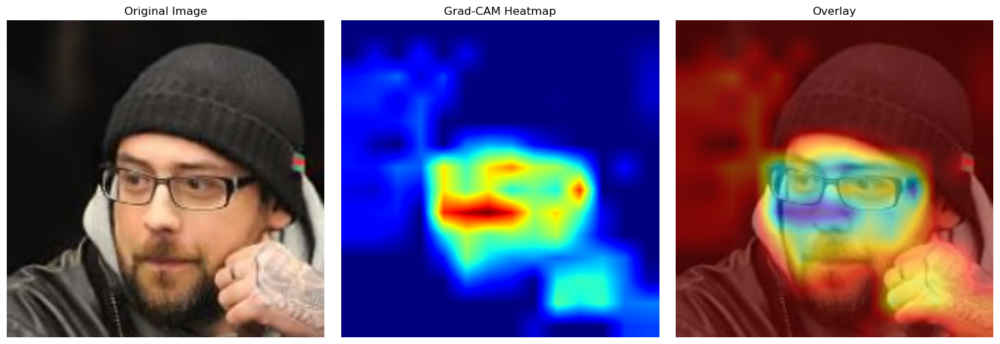

attaGan


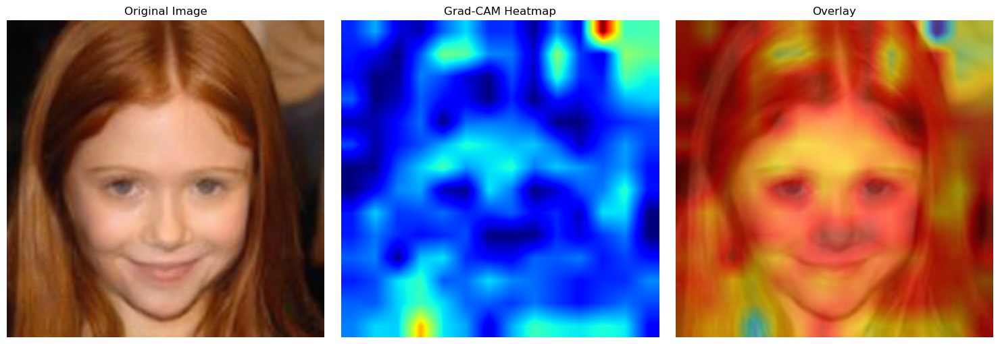

stargan


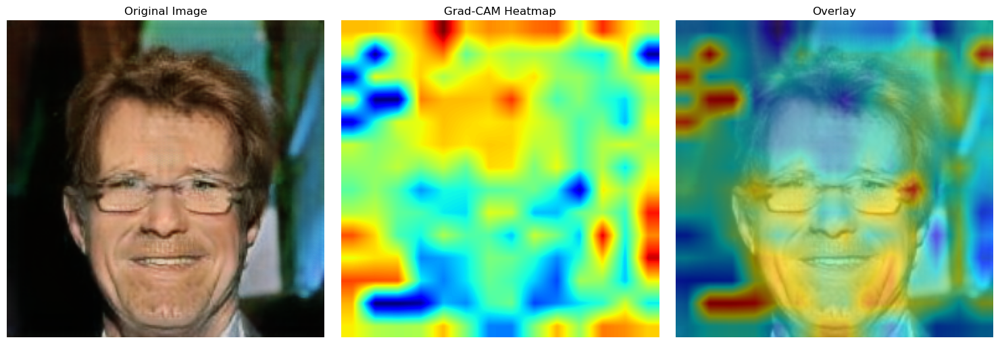

stylegan 2


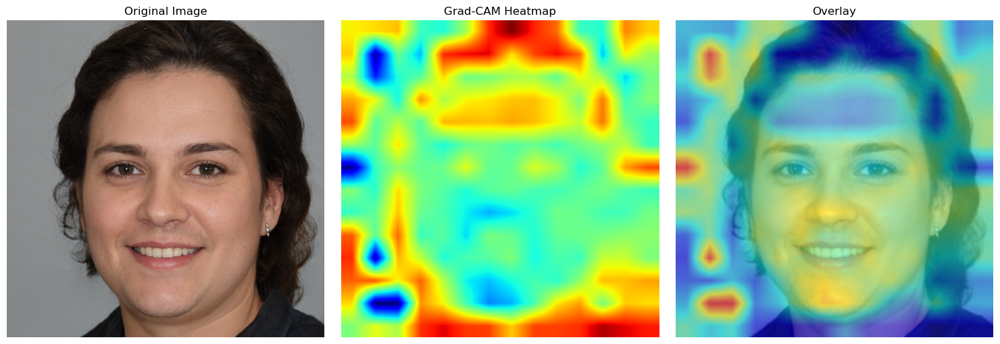

stylegan 1


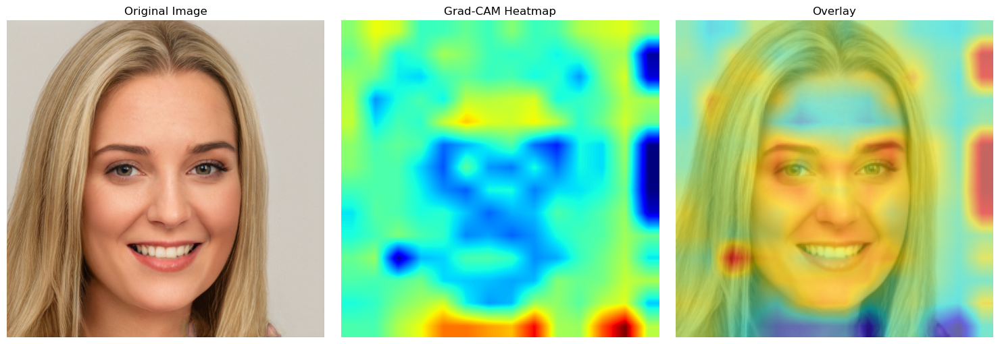

Dataset: Celeb


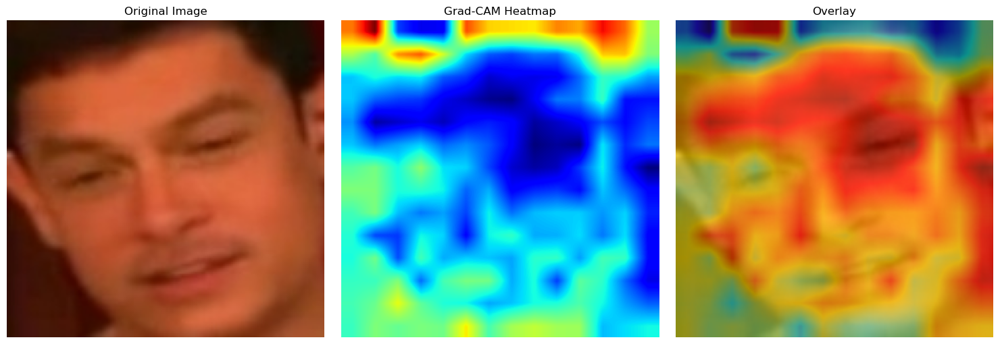

Dataset: FF++
DFD


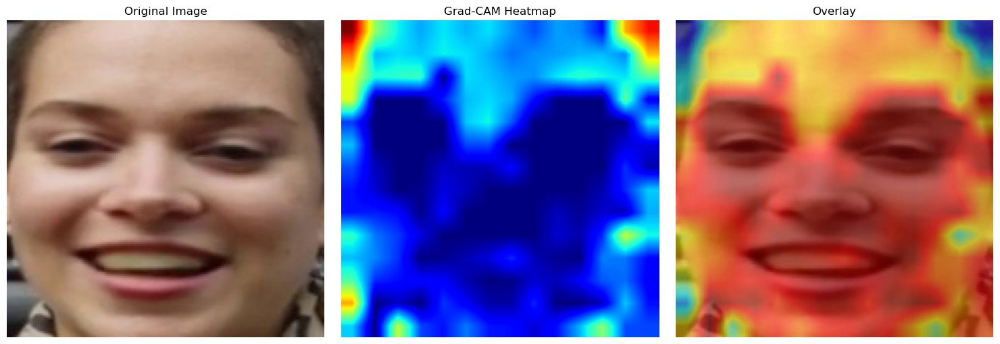

DF


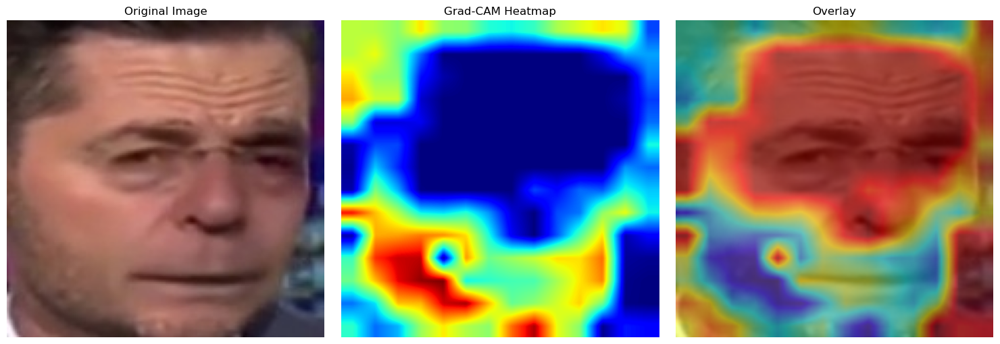

Faceshifter


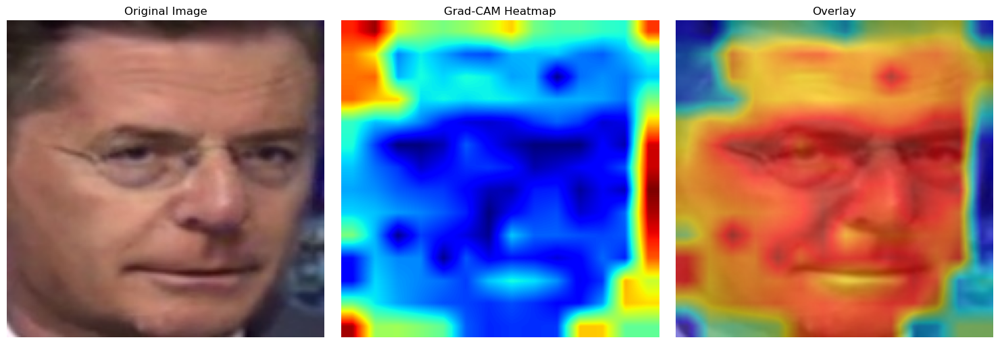

Faceswap


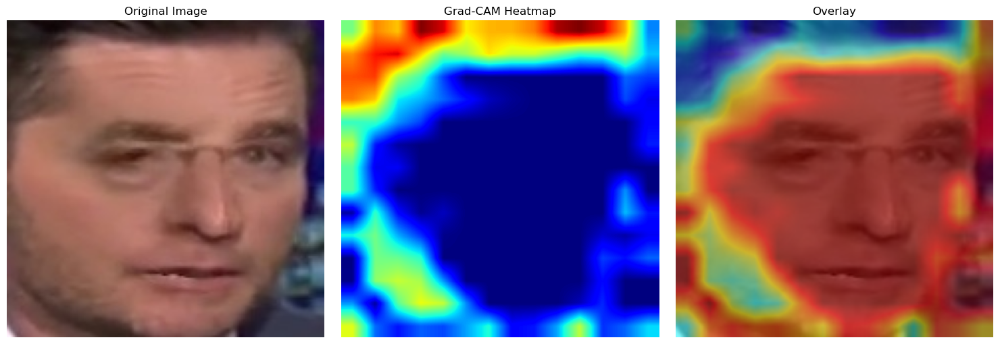

F2f


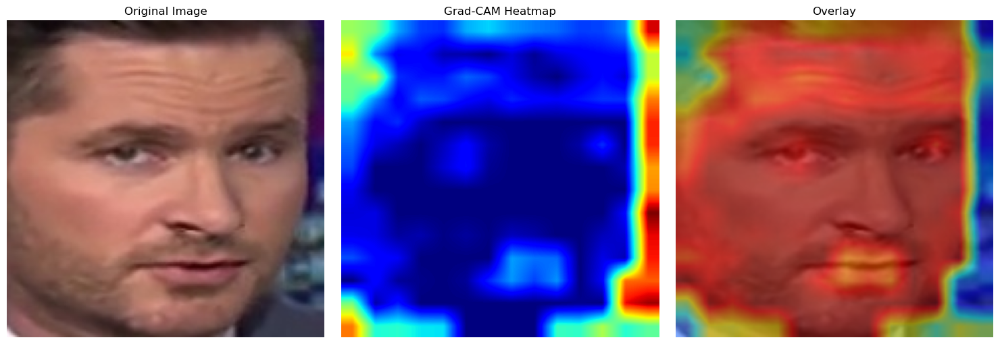

NT


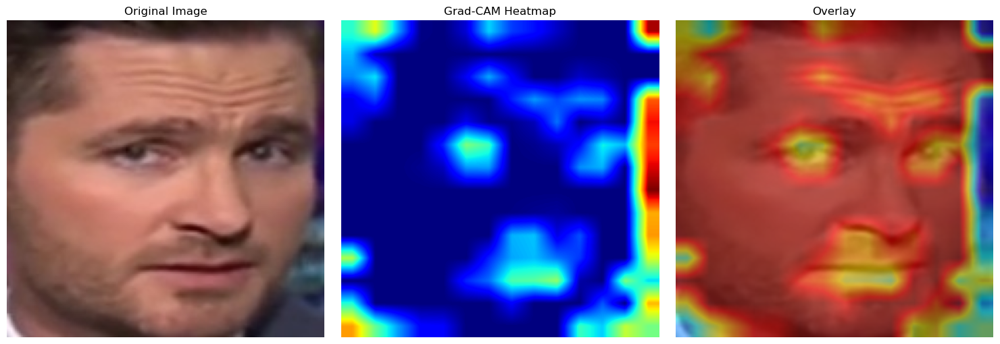

array([[[0.52465487, 0.5424063 , 0.08678502],
        [0.52465487, 0.5424063 , 0.08678502],
        [0.52465487, 0.5424063 , 0.08678502],
        ...,
        [0.0887574 , 0.04733728, 0.45759374],
        [0.08481263, 0.04142012, 0.4595661 ],
        [0.08284024, 0.03944774, 0.4615385 ]],

       [[0.52662724, 0.54437876, 0.0887574 ],
        [0.52662724, 0.54437876, 0.0887574 ],
        [0.52662724, 0.54437876, 0.08678502],
        ...,
        [0.09072979, 0.04930967, 0.45759374],
        [0.08481263, 0.04142012, 0.45759374],
        [0.08284024, 0.03944774, 0.4595661 ]],

       [[0.5285996 , 0.5463511 , 0.09072979],
        [0.5285996 , 0.5463511 , 0.09072979],
        [0.530572  , 0.5483235 , 0.0887574 ],
        ...,
        [0.09072979, 0.05325444, 0.45562133],
        [0.08481263, 0.04339251, 0.45364892],
        [0.08086786, 0.04142012, 0.45562133]],

       ...,

       [[0.4418146 , 0.69428015, 0.9526627 ],
        [0.4575937 , 0.7061144 , 0.9644971 ],
        [0.47731757, 0

In [14]:
# Load and process image
print("VIT 16")
print("Dataset: DFC")
print("GDWCT")
image_path = "D:/thesis/dataset/deepfake dataset/1-GDWCT/62.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("attaGan")
image_path = "D:/thesis/dataset/deepfake dataset/1-ATTGAN/37.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stargan")
image_path = "D:/thesis/dataset/deepfake dataset/1-StarGAN/image_200.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stylegan 2")
image_path = "D:/thesis/dataset/deepfake dataset/1-STYLEGAN2/000200.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stylegan 1")
image_path = "D:/thesis/dataset/deepfake dataset/1-STYLEGAN/000201.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
########################################################################################################
print("Dataset: Celeb")
image_path = "D:\\thesis\\dataset\\Celeb-DF-v2\\id00p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Dataset: FF++")
print("DFD")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\dfd_001p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("DF")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\df_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Faceshifter")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\faceshifter_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Faceswap")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\faceswap_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("F2f")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\f2f_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("NT")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\nt_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)



# DFC

In [12]:
import h5py
import numpy as np
# Open the HDF5 file in read mode
with h5py.File('D://thesis//dataset//deepfake dataset//resized_images.h5', 'r') as h5f:
    # Access each dataset
    celeb = np.array(h5f['celeb'])
    ffhq = np.array(h5f['ffhq'])
    gdwct = np.array(h5f['gdwct'])
    attgan = np.array(h5f['attgan'])
    stargan = np.array(h5f['stargan'])
    stylegan2 = np.array(h5f['stylegan2'])
    stylegan = np.array(h5f['stylegan'])

# Now, 'celeb', 'ffhq', etc., are NumPy arrays containing your datasets
print(f"celeb shape: {celeb.shape}, dtype: {celeb.dtype}")
print(f"ffhq shape: {ffhq.shape}, dtype: {ffhq.dtype}")
print(f"ffhq shape: {gdwct.shape}, dtype: {gdwct.dtype}")
print(f"ffhq shape: {attgan.shape}, dtype: {attgan.dtype}")
print(f"ffhq shape: {stargan.shape}, dtype: {stargan.dtype}")
print(f"ffhq shape: {stylegan2.shape}, dtype: {stylegan2.dtype}")
print(f"ffhq shape: {stylegan.shape}, dtype: {stylegan.dtype}")
# Repeat for other datasets as needed
import cv2
# Function to resize images from (224, 224) to (160, 160)
def resize_images(image_array, target_size=(160, 160)):
    resized_images = np.array([cv2.resize(img, target_size) for img in image_array])
    return resized_images

celeb = resize_images(celeb, target_size=(160, 160))
ffhq = resize_images(ffhq, target_size=(160, 160))
gdwct = resize_images(gdwct, target_size=(160, 160))
attgan = resize_images(attgan, target_size=(160, 160))
stargan = resize_images(stargan, target_size=(160, 160))
stylegan = resize_images(stargan, target_size=(160, 160))
stylegan2 = resize_images(stylegan2, target_size=(160, 160))
import random
# Randomly select 2500 distinct images
random_indices = random.sample(range(len(celeb)), 2500)  # Get 2500 random indices
celeb = celeb[random_indices]  # Select the random subse

import random
# Randomly select 2500 distinct images
random_indices = random.sample(range(len(ffhq)), 2500)  # Get 2500 random indices
ffhq = ffhq[random_indices]  # Select the random subse
print(f"celeb shape: {celeb.shape}, dtype: {celeb.dtype}")
print(f"ffhq shape: {ffhq.shape}, dtype: {ffhq.dtype}")
print(f"gdwct shape: {gdwct.shape}, dtype: {gdwct.dtype}")
print(f"attagan shape: {attgan.shape}, dtype: {attgan.dtype}")
print(f"stargan shape: {stargan.shape}, dtype: {stargan.dtype}")
print(f"stylegan2 shape: {stylegan2.shape}, dtype: {stylegan2.dtype}")
print(f"stylegan shape: {stylegan.shape}, dtype: {stylegan.dtype}")
import random
import numpy as np

def split_data(data, train_ratio=0.7):
    """
    Splits data into training and testing sets based on the specified ratio.

    Parameters:
        data (list or np.array): The dataset to split.
        train_ratio (float): The ratio of the data to include in the training set.

    Returns:
        tuple: Two datasets - train and test.
    """
    # Shuffle the data
    random.shuffle(data)

    # Calculate the split index
    split_index = int(len(data) * train_ratio)

    # Split the data
    train_data = data[:split_index]
    test_data = data[split_index:]

    return train_data, test_data

# Split `celeb` into 70% train and 30% test
celeb_train_hog, celeb_test_hog = split_data(celeb, train_ratio=0.7)

# Split `ffhq` into 70% train and 30% test
ffhq_train_hog, ffhq_test_hog = split_data(ffhq, train_ratio=0.7)

# Split `attgan` into 70% train and 30% test
attgan_train_hog, attgan_test_hog = split_data(attgan, train_ratio=0.7)

# Split `stargan` into 70% train and 30% test
stargan_train_hog, stargan_test_hog = split_data(stargan, train_ratio=0.7)

# Split `gdwct` into 70% train and 30% test
gdwct_train_hog, gdwct_test_hog = split_data(gdwct, train_ratio=0.7)

# Split `stylegan2` into 70% train and 30% test_hog
stylegan2_train_hog, stylegan2_test_hog = split_data(stylegan2, train_ratio=0.7)

# Split `stylegan` into 70% train and 30% test_hog
stylegan_train_hog, stylegan_test_hog = split_data(stylegan, train_ratio=0.7)

# Convert to NumPy arrays if needed
celeb_train_hog, celeb_test_hog = np.array(celeb_train_hog), np.array(celeb_test_hog)
ffhq_train_hog, ffhq_test_hog = np.array(ffhq_train_hog), np.array(ffhq_test_hog)
attgan_train_hog, attgan_test_hog = np.array(attgan_train_hog), np.array(attgan_test_hog)
stargan_train_hog, stargan_test_hog = np.array(stargan_train_hog), np.array(stargan_test_hog)
gdwct_train_hog, gdwct_test_hog = np.array(gdwct_train_hog), np.array(gdwct_test_hog)
stylegan2_train_hog, stylegan2_test_hog = np.array(stylegan2_train_hog), np.array(stylegan2_test_hog)
stylegan_train_hog, stylegan_test_hog = np.array(stylegan_train_hog), np.array(stylegan_test_hog)

# Print results for verification
print(f"celeb_train: {len(celeb_train_hog)} images, celeb_test: {len(celeb_test_hog)} images")
print(f"ffhq_train: {len(ffhq_train_hog)} images, ffhq_test: {len(ffhq_test_hog)} images")
print(f"attgan_train: {len(attgan_train_hog)} images, attgan_test: {len(attgan_test_hog)} images")
print(f"stargan_train: {len(stargan_train_hog)} images, stargan_test: {len(stargan_test_hog)} images")
print(f"gdwct_train: {len(gdwct_train_hog)} images, gdwct_test: {len(gdwct_test_hog)} images")
print(f"stylegan2_train: {len(stylegan2_train_hog)} images, stylegan2_test: {len(stylegan2_test_hog)} images")
print(f"stylegan_train: {len(stylegan_train_hog)} images, stylegan_test: {len(stylegan_test_hog)} images")

########################################################################################################################################
#######################################divide into 60,10 train and val
#########################################################################################################################################
def extract_validation(train_data):
    """
    Extract every 10th sample from the training data and store it in a validation set.

    Parameters:
        train_data (list or np.array): The training dataset.

    Returns:
        tuple: Updated training dataset and validation dataset.
    """
    # Select every 10th sample for the validation set
    validation_data = train_data[::10]

    # Remove the selected samples from the training dataset
    updated_train_data = [train_data[i] for i in range(len(train_data)) if i % 10 != 0]

    return np.array(updated_train_data), np.array(validation_data)


# Perform the operation for each dataset
celeb_train_hog, celeb_val_hog = extract_validation(celeb_train_hog)
ffhq_train_hog, ffhq_val_hog = extract_validation(ffhq_train_hog)
attgan_train_hog, attgan_val_hog = extract_validation(attgan_train_hog)
stargan_train_hog, stargan_val_hog = extract_validation(stargan_train_hog)
gdwct_train_hog, gdwct_val_hog = extract_validation(gdwct_train_hog)
stylegan2_train_hog, stylegan2_val_hog = extract_validation(stylegan2_train_hog)
stylegan_train_hog, stylegan_val_hog = extract_validation(stylegan_train_hog)

# Print results for verification
print(f"celeb_train: {len(celeb_train_hog)} images, celeb_val: {len(celeb_val_hog)} images")
print(f"ffhq_train: {len(ffhq_train_hog)} images, ffhq_val: {len(ffhq_val_hog)} images")
print(f"attgan_train: {len(attgan_train_hog)} images, attgan_val: {len(attgan_val_hog)} images")
print(f"stargan_train: {len(stargan_train_hog)} images, stargan_val: {len(stargan_val_hog)} images")
print(f"gdwct_train: {len(gdwct_train_hog)} images, gdwct_val: {len(gdwct_val_hog)} images")
print(f"stylegan2_train: {len(stylegan2_train_hog)} images, stylegan2_val: {len(stylegan2_val_hog)} images")
print(f"stylegan_train: {len(stylegan_train_hog)} images, stylegan_val: {len(stylegan_val_hog)} images")
############################################################################################################################################################
#################################################concatenate the labels 0,1 real and fake
#############################################################################################################################################################


celeb_train_labels = np.zeros(len(celeb_train_hog), dtype=int)
ffhq_train_labels = np.zeros(len(ffhq_train_hog), dtype=int)
atta_train_labels = np.ones(len(attgan_train_hog), dtype=int)
star_train_labels = np.ones(len(stargan_train_hog), dtype=int)
gdwct_train_labels = np.ones(len(gdwct_train_hog), dtype=int)
stylegan2_train_labels = np.ones(len(stylegan2_train_hog), dtype=int)
stylegan_train_labels = np.ones(len(stylegan_train_hog), dtype=int)

# Concatenate all training datasets into a single `train` variable
train_hog = np.concatenate([celeb_train_hog, ffhq_train_hog, attgan_train_hog, stargan_train_hog, gdwct_train_hog, stylegan2_train_hog, stylegan_train_hog], axis=0)
train_labels=np.concatenate([celeb_train_labels, ffhq_train_labels, atta_train_labels, star_train_labels, gdwct_train_labels, stylegan2_train_labels,
                              stylegan_train_labels], axis=0)




celeb_test_labels = np.zeros(len(celeb_test_hog), dtype=int)
ffhq_test_labels = np.zeros(len(ffhq_test_hog), dtype=int)
atta_test_labels = np.ones(len(attgan_test_hog), dtype=int)
star_test_labels = np.ones(len(stargan_test_hog), dtype=int)
gdwct_test_labels = np.ones(len(gdwct_test_hog), dtype=int)
stylegan2_test_labels = np.ones(len(stylegan2_test_hog), dtype=int)
stylegan_test_labels = np.ones(len(stylegan_test_hog), dtype=int)

# Concatenate all testing datasets into a single `test` variable
test_hog = np.concatenate([celeb_test_hog, ffhq_test_hog, attgan_test_hog, stargan_test_hog, gdwct_test_hog, stylegan2_test_hog, stylegan_test_hog], axis=0)
test_labels = np.concatenate([celeb_test_labels, ffhq_test_labels, atta_test_labels, star_test_labels, gdwct_test_labels, stylegan2_test_labels,
                        stylegan_test_labels], axis=0)




celeb_val_labels = np.zeros(len(celeb_val_hog), dtype=int)
ffhq_val_labels = np.zeros(len(ffhq_val_hog), dtype=int)
atta_val_labels = np.ones(len(attgan_val_hog), dtype=int)
star_val_labels = np.ones(len(stargan_val_hog), dtype=int)
gdwct_val_labels = np.ones(len(gdwct_val_hog), dtype=int)
stylegan2_val_labels = np.ones(len(stylegan2_val_hog), dtype=int)
stylegan_val_labels = np.ones(len(stylegan_val_hog), dtype=int)

# Concatenate all validation datasets into a single `val` variable
val_hog = np.concatenate([celeb_val_hog, ffhq_val_hog, attgan_val_hog, stargan_val_hog, gdwct_val_hog, stylegan2_val_hog, stylegan_val_hog], axis=0)
val_labels = np.concatenate([celeb_val_labels, ffhq_val_labels, atta_val_labels, star_val_labels, gdwct_val_labels, stylegan2_val_labels,
                       stylegan_val_labels], axis=0)

# Print the results for verification
print(f"Total train: {len(train_hog)} images")
print(f"Total test: {len(test_hog)} images")
print(f"Total val: {len(val_hog)} images")


# Print results for verification
print(f"Train Labels: {len(train_labels)} ")
print(f"Test Labels: {len(test_labels)} ")
print(f"Val Labels: {len(val_labels)} ")



celeb shape: (5000, 224, 224, 3), dtype: uint8
ffhq shape: (5000, 224, 224, 3), dtype: uint8
ffhq shape: (1000, 224, 224, 3), dtype: uint8
ffhq shape: (1000, 224, 224, 3), dtype: uint8
ffhq shape: (1000, 224, 224, 3), dtype: uint8
ffhq shape: (1000, 224, 224, 3), dtype: uint8
ffhq shape: (1000, 224, 224, 3), dtype: uint8
celeb shape: (2500, 160, 160, 3), dtype: uint8
ffhq shape: (2500, 160, 160, 3), dtype: uint8
gdwct shape: (1000, 160, 160, 3), dtype: uint8
attagan shape: (1000, 160, 160, 3), dtype: uint8
stargan shape: (1000, 160, 160, 3), dtype: uint8
stylegan2 shape: (1000, 160, 160, 3), dtype: uint8
stylegan shape: (1000, 160, 160, 3), dtype: uint8
celeb_train: 1750 images, celeb_test: 750 images
ffhq_train: 1750 images, ffhq_test: 750 images
attgan_train: 700 images, attgan_test: 300 images
stargan_train: 700 images, stargan_test: 300 images
gdwct_train: 700 images, gdwct_test: 300 images
stylegan2_train: 700 images, stylegan2_test: 300 images
stylegan_train: 700 images, stylegan

In [13]:
# Convert data into PyTorch Dataset
train_dataset = ImageDataset(train_hog, train_labels, feature_extractor)
val_dataset = ImageDataset(val_hog, val_labels, feature_extractor)
test_dataset = ImageDataset(test_hog, test_labels, feature_extractor)

# Dataloaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [14]:
# Train the model
epochs = 10  # Increase epochs for better accuracy
train_model(model, train_loader, val_loader, epochs)

# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy: {test_accuracy:.4f}")


Epoch 1/10 | Loss: 0.2439 | Train Acc: 0.9170 | Val Acc: 0.9743
Epoch 2/10 | Loss: 0.0711 | Train Acc: 0.9929 | Val Acc: 0.9900
Epoch 3/10 | Loss: 0.0312 | Train Acc: 0.9973 | Val Acc: 0.9800
Epoch 4/10 | Loss: 0.0135 | Train Acc: 0.9986 | Val Acc: 0.9900
Epoch 5/10 | Loss: 0.0091 | Train Acc: 0.9994 | Val Acc: 0.9943
Epoch 6/10 | Loss: 0.0000 | Train Acc: 1.0000 | Val Acc: 0.9943
Epoch 7/10 | Loss: 0.0000 | Train Acc: 1.0000 | Val Acc: 0.9943
Epoch 8/10 | Loss: 0.0000 | Train Acc: 1.0000 | Val Acc: 0.9943
Epoch 9/10 | Loss: 0.0000 | Train Acc: 1.0000 | Val Acc: 0.9943
Epoch 10/10 | Loss: 0.0000 | Train Acc: 1.0000 | Val Acc: 0.9943
Test Accuracy: 0.9943


In [16]:
# Your data loading operations here
time.sleep(2)  # Simulate loading time

end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")
print(f"Power Consumption: {int(end['power_w'])}W")  # Rounded to whole watts


=== RESOURCE USAGE ===
CPU Usage: 18.0%
RAM Used: 11287.7 MB
Time Usage: 15153.9 s
GPU Memory Used: 0.0 MB
Power Consumption: 93W


In [9]:
print("=== DATA LOADING ===")
start = monitor.get_stats()
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy of DFC: {test_accuracy:.4f}")
# Your data loading operations here
time.sleep(2)  # Simulate loading time

end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")#4.4
print(f"Power Consumption: {int(end['power_w'])}W")  # Rounded to whole watts

=== DATA LOADING ===
Test Accuracy of DFC: 0.9853

=== RESOURCE USAGE ===
CPU Usage: 2.8%
RAM Used: 45.7 MB
Time Usage: 37.5 s
GPU Memory Used: 0.0 MB
Power Consumption: 93W


In [15]:
print("=== DATA LOADING ===")
start = monitor1.get_stats()
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
# Your data loading operations here
time.sleep(2)  # Simulate loading time

end = monitor1.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")

=== DATA LOADING ===

=== RESOURCE USAGE ===
CPU Usage: 6.0%
Time Usage: 85.0 s
GPU Memory Used: 659.8 MB


In [16]:
start = monitor.get_stats()
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")

RAM Used: 129.8 MB


In [16]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_metrics(model, loader):
    model.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}
            labels = labels.to(device).long()

            outputs = model(**inputs).logits
            preds = outputs.argmax(1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    precision = precision_score(all_labels, all_preds, average='weighted')
    recall = recall_score(all_labels, all_preds, average='weighted')
    f1 = f1_score(all_labels, all_preds, average='weighted')
    
    return precision, recall, f1

# Calculate metrics on test data
precision, recall, f1 = evaluate_metrics(model, test_loader)

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

Precision: 0.9943
Recall: 0.9943
F1 Score: 0.9943


In [21]:
test_dataset = ImageDataset(test, test_labels, feature_extractor)
# Dataloaders
batch_size = 16
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy of Celeb-DFv2 on DFC ON (VIT16): {test_accuracy:.4f}")

Test Accuracy of Celeb-DFv2 on DFC ON (VIT16): 0.7137


In [18]:
test_dataset = ImageDataset(test_ff, test_labels_ff, feature_extractor)
# Dataloaders
batch_size = 16
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy of FF++ on dfc ON (VIT16): {test_accuracy:.4f}")


Test Accuracy of FF++ on dfc ON (VIT16): 0.6631


In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from transformers import ViTImageProcessor, ViTForImageClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
from PIL import Image
import os
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms

# Create a directory for saving models
save_dir = "D:/thesis/article 2/ViT/saved_models_dfc/"
os.makedirs(save_dir, exist_ok=True)

# Load ViT model and processor
feature_extractor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")

# Modify the classifier head for binary classification
model.classifier = nn.Linear(model.config.hidden_size, 2)  # 2 classes for binary classification

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Custom Dataset Class
class ImageDataset(Dataset):
    def __init__(self, images, labels, processor):
        self.images = images
        self.labels = labels
        self.processor = processor
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]

        if isinstance(image, np.ndarray):
            image = Image.fromarray(image)
        elif isinstance(image, str):
            image = Image.open(image).convert("RGB")

        image = image.resize((224, 224))  # Resize to ViT input size
        inputs = self.processor(image, return_tensors="pt")

        return {key: val.squeeze(0) for key, val in inputs.items()}, torch.tensor(label)

# Evaluation function
def evaluate(model, loader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}  # Ensure float32
            labels = labels.to(device).long()  # Ensure labels are long

            outputs = model(**inputs).logits
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

    return correct / total

# Training function with checkpointing
def train_model(model, train_loader, val_loader, epochs=5):
    # Define optimizer and criterion
    optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)
    criterion = nn.CrossEntropyLoss()
    
    # Initialize variables for tracking best model
    best_val_acc = 0.0
    best_epoch = 0
    
    # Training loop
    for epoch in range(epochs):
        model.train()
        total_loss = 0
        correct = 0
        total = 0

        for batch_idx, batch in enumerate(train_loader):
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}
            labels = labels.to(device).long()
            
            optimizer.zero_grad()
            outputs = model(**inputs).logits
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)
            
            # Print progress
            if batch_idx % 50 == 0:
                print(f'Epoch: {epoch+1}/{epochs} | Batch: {batch_idx}/{len(train_loader)} | Loss: {loss.item():.4f}')

        # Calculate metrics
        train_acc = correct / total
        val_acc = evaluate(model, val_loader)
        
        print(f"Epoch {epoch+1}/{epochs} | Loss: {total_loss/len(train_loader):.4f} | Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")
        
        # Save checkpoint if this is the best model so far
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_epoch = epoch + 1
            
            # Save model and optimizer state
            checkpoint = {
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }
            
            checkpoint_path = os.path.join(save_dir, f'vit_best_model_epoch_{epoch+1}.pth')
            torch.save(checkpoint, checkpoint_path)
            print(f"Saved best model with validation accuracy: {val_acc:.4f}")
        
        # Save a checkpoint every few epochs
        if (epoch + 1) % 2 == 0:  # Save every 2 epochs
            checkpoint_path = os.path.join(save_dir, f'vit_checkpoint_epoch_{epoch+1}.pth')
            torch.save({
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }, checkpoint_path)
    
    # Save the final model
    final_model_path = os.path.join(save_dir, 'vit_final_model.pth')
    torch.save(model.state_dict(), final_model_path)
    
    # Also save the complete model for easier loading
    complete_model_path = os.path.join(save_dir, 'vit_complete_model.pth')
    torch.save({
        'model_state_dict': model.state_dict(),
        'feature_extractor': feature_extractor,
        'model_config': model.config
    }, complete_model_path)
    
    print(f"Training completed. Best validation accuracy: {best_val_acc:.4f} at epoch {best_epoch}")
    return best_val_acc

# Function to load a saved model
def load_saved_model(model_path, device):
    checkpoint = torch.load(model_path, map_location=device)
    
    # Create a new model instance
    model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")
    model.classifier = nn.Linear(model.config.hidden_size, 2)
    
    # Load the saved weights
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()
    
    return model

# Grad-CAM implementation for ViT
class ViTGradCAM:
    def __init__(self, model, feature_extractor):
        self.model = model
        self.feature_extractor = feature_extractor
        self.gradients = None
        self.activations = None
        self.model.eval()
        self._register_hooks()
    
    def _register_hooks(self):
        # Register hooks to get gradients and activations
        # For ViT, we'll use the last transformer block
        target_layer = self.model.vit.encoder.layer[-1]
        
        def forward_hook(module, input, output):
            self.activations = output[0]  # output is a tuple, first element is the hidden states
        
        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0]  # grad_output is a tuple
        
        self.forward_handle = target_layer.register_forward_hook(forward_hook)
        self.backward_handle = target_layer.register_backward_hook(backward_hook)
    
    def __call__(self, input_tensor, target_class=None):
        # Forward pass
        outputs = self.model(**input_tensor)
        
        if target_class is None:
            target_class = outputs.logits.argmax(dim=1).item()
        
        # Backward pass
        self.model.zero_grad()
        loss = outputs.logits[0, target_class]
        loss.backward()
        
        # Get gradients and activations
        gradients = self.gradients.detach().cpu().numpy()[0]
        activations = self.activations.detach().cpu().numpy()[0]
        
        # Global average pooling of gradients
        weights = np.mean(gradients, axis=0)
        
        # Weight the activations
        cam = np.zeros(activations.shape[1:], dtype=np.float32)
        for i, w in enumerate(weights):
            cam += w * activations[i]
        
        # Apply ReLU
        cam = np.maximum(cam, 0)
        
        # Normalize
        cam = cam - np.min(cam)
        cam = cam / np.max(cam) if np.max(cam) > 0 else cam
        
        # Resize to match input image size
        cam = cv2.resize(cam, (224, 224))
        
        return cam
    
    def remove_hooks(self):
        self.forward_handle.remove()
        self.backward_handle.remove()

# Function to visualize Grad-CAM
def visualize_gradcam(image_path, model, feature_extractor, target_class=None):
    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    image = image.resize((224, 224))
    
    # Preprocess for ViT
    inputs = feature_extractor(image, return_tensors="pt")
    inputs = {key: val.to(device) for key, val in inputs.items()}
    
    # Create Grad-CAM
    gradcam = ViTGradCAM(model, feature_extractor)
    cam = gradcam(inputs, target_class)
    gradcam.remove_hooks()
    
    # Convert to heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    
    # Convert image to numpy array
    image_np = np.array(image) / 255.0
    image_np = cv2.cvtColor(image_np, cv2.COLOR_RGB2BGR)
    
    # Blend image and heatmap
    cam_image = heatmap + np.float32(image_np)
    cam_image = cam_image / np.max(cam_image)
    
    # Display results
    plt.figure(figsize=(10, 5))
    
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.imshow(cam, cmap='jet')
    plt.title("Grad-CAM Heatmap")
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.imshow(cam_image)
    plt.title("Overlay")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return cam_image

# Assuming you have your data loaded as train, train_labels, val, val_labels, test, test_labels

# Convert data into PyTorch Dataset
train_dataset = ImageDataset(train_hog, train_labels, feature_extractor)
val_dataset = ImageDataset(val_hog, val_labels, feature_extractor)
test_dataset = ImageDataset(test_hog, test_labels, feature_extractor)

# Dataloaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Train the model
epochs = 5  # You can increase this for better accuracy
best_val_acc = train_model(model, train_loader, val_loader, epochs)

# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy: {test_accuracy:.4f}")



c:\Users\aneek\anaconda3\envs\tf_gpu_env\lib\site-packages\huggingface_hub\file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch: 1/5 | Batch: 0/394 | Loss: 0.6706
Epoch: 1/5 | Batch: 50/394 | Loss: 0.1459
Epoch: 1/5 | Batch: 100/394 | Loss: 0.1210
Epoch: 1/5 | Batch: 150/394 | Loss: 0.0560
Epoch: 1/5 | Batch: 200/394 | Loss: 0.5578
Epoch: 1/5 | Batch: 250/394 | Loss: 0.0398
Epoch: 1/5 | Batch: 300/394 | Loss: 0.0119
Epoch: 1/5 | Batch: 350/394 | Loss: 0.0136
Epoch 1/5 | Loss: 0.1730 | Train Acc: 0.9254 | Val Acc: 0.9643
Saved best model with validation accuracy: 0.9643
Epoch: 2/5 | Batch: 0/394 | Loss: 0.0446
Epoch: 2/5 | Batch: 50/394 | Loss: 0.0742
Epoch: 2/5 | Batch: 100/394 | Loss: 0.0041
Epoch: 2/5 | Batch: 150/394 | Loss: 0.0092
Epoch: 2/5 | Batch: 200/394 | Loss: 0.0041
Epoch: 2/5 | Batch: 250/394 | Loss: 0.2238
Epoch: 2/5 | Batch: 300/394 | Loss: 0.0064
Epoch: 2/5 | Batch: 350/394 | Loss: 0.0050
Epoch 2/5 | Loss: 0.0407 | Train Acc: 0.9873 | Val Acc: 0.9829
Saved best model with validation accuracy: 0.9829
Epoch: 3/5 | Batch: 0/394 | Loss: 0.0040
Epoch: 3/5 | Batch: 50/394 | Loss: 0.0028
Epoch: 3/

VIT 16
Dataset: DFC
GDWCT


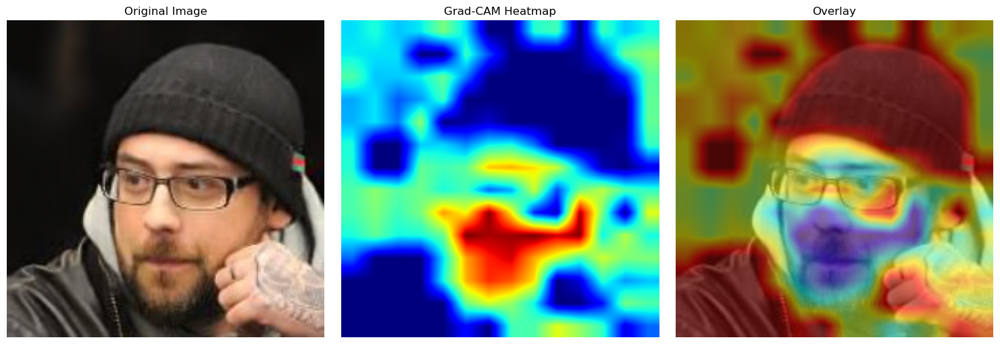

attaGan


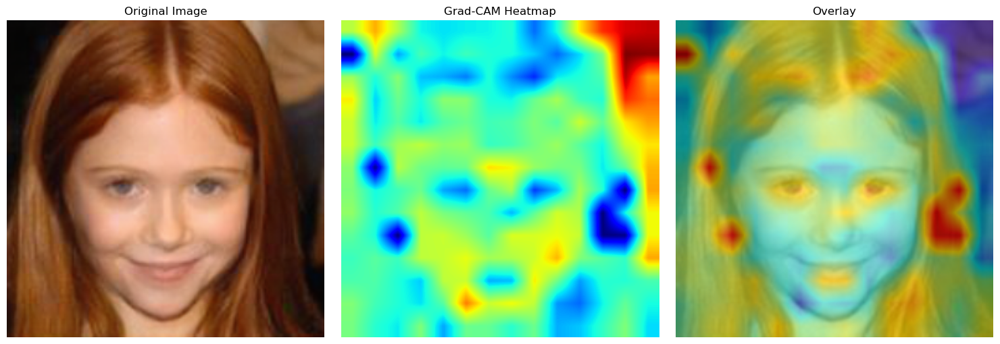

stargan


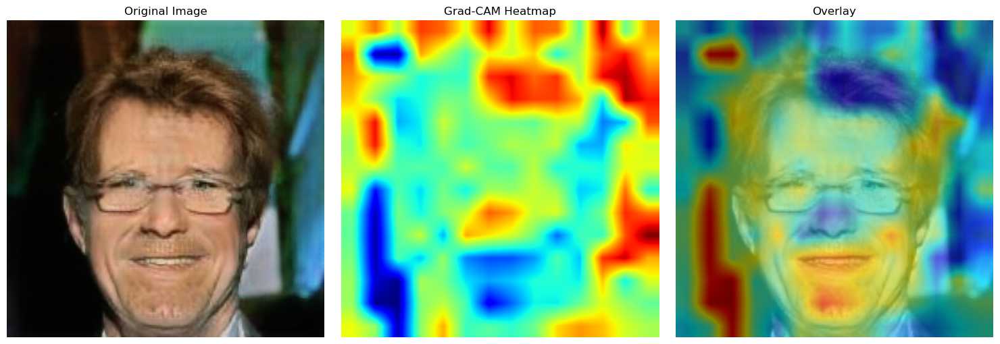

stylegan 2


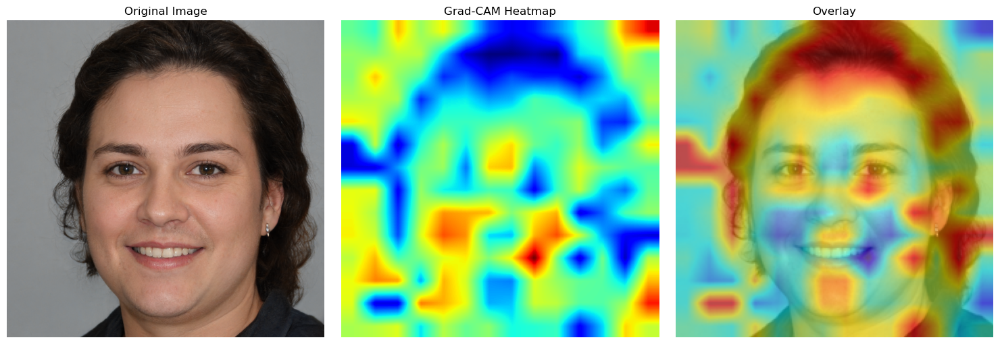

stylegan 1


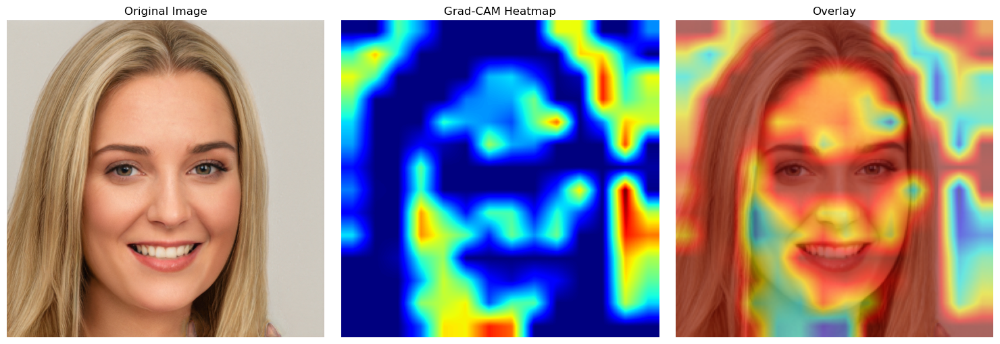

Dataset: Celeb


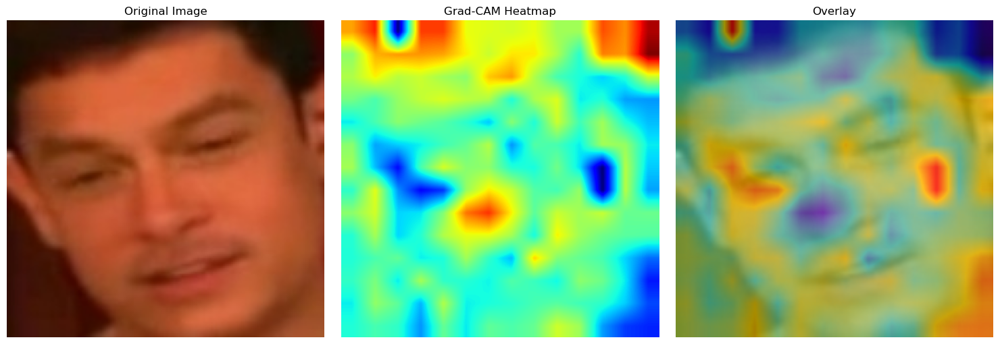

Dataset: FF++
DFD


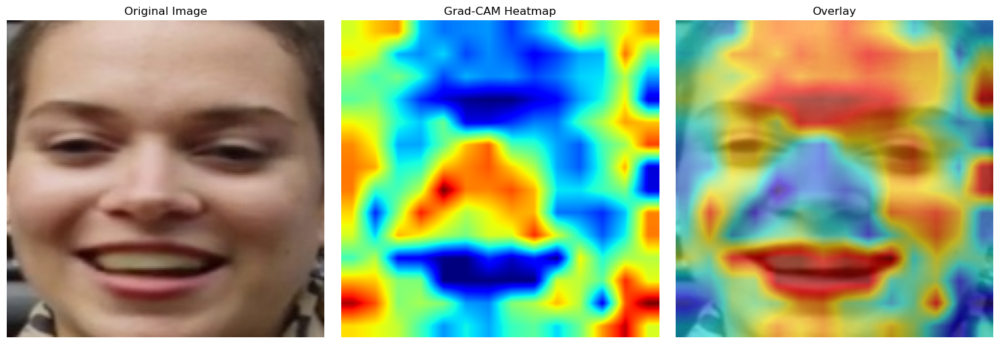

DF


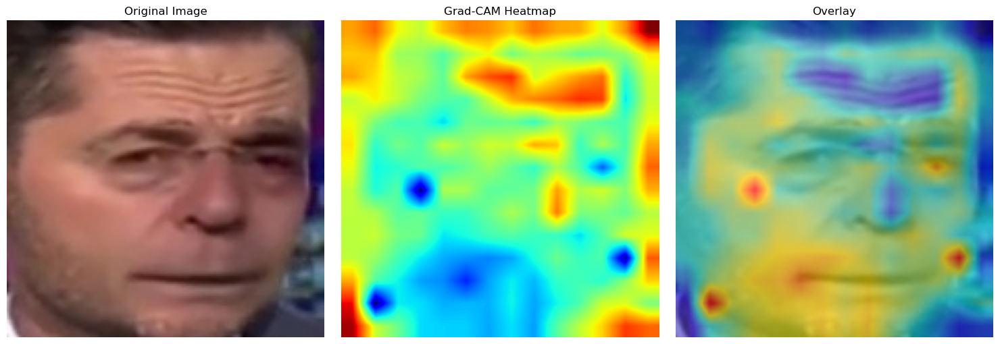

Faceshifter


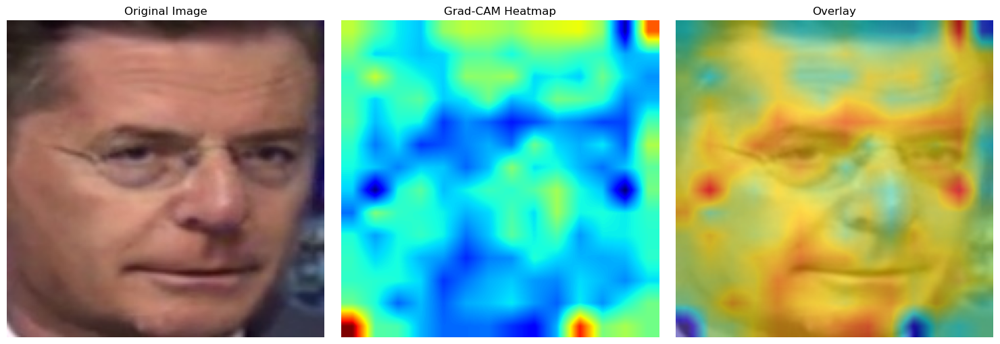

Faceswap


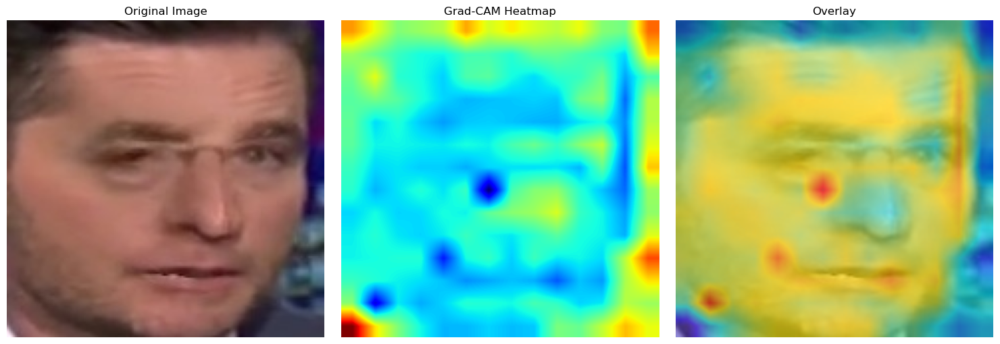

F2f


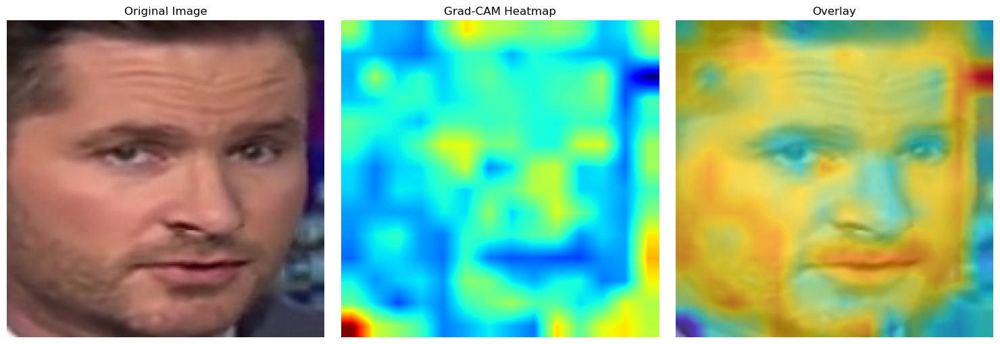

NT


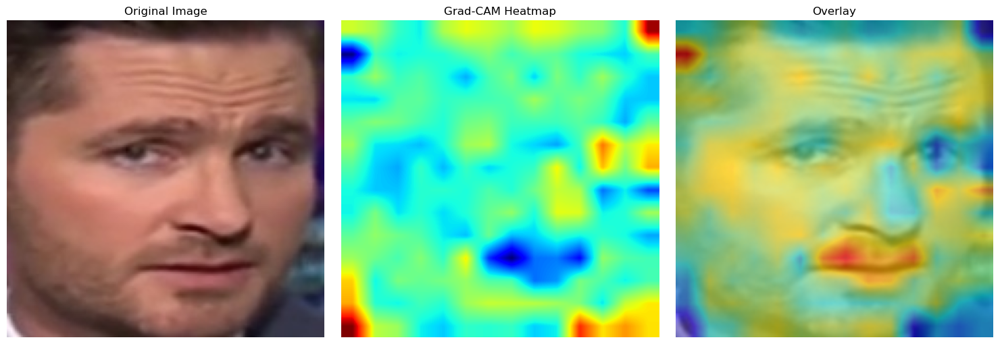

array([[[0.06837607, 0.5555556 , 0.5918803 ],
        [0.06837607, 0.5555556 , 0.5918803 ],
        [0.06837607, 0.5555556 , 0.5918803 ],
        ...,
        [0.09615385, 0.05128205, 0.4700855 ],
        [0.09188034, 0.0448718 , 0.47222224],
        [0.08974359, 0.04273504, 0.474359  ]],

       [[0.07051282, 0.5576923 , 0.59401715],
        [0.07051282, 0.5576923 , 0.59401715],
        [0.07051282, 0.5576923 , 0.5918803 ],
        ...,
        [0.0982906 , 0.0534188 , 0.4700855 ],
        [0.09188034, 0.0448718 , 0.4700855 ],
        [0.08974359, 0.04273504, 0.47222224]],

       [[0.07264958, 0.5598291 , 0.59615386],
        [0.07264958, 0.5598291 , 0.59615386],
        [0.07478633, 0.5619658 , 0.59401715],
        ...,
        [0.0982906 , 0.05769231, 0.46794873],
        [0.09188034, 0.04700855, 0.46581197],
        [0.08760684, 0.0448718 , 0.46794873]],

       ...,

       [[0.47863248, 0.46153846, 0.7606838 ],
        [0.4957265 , 0.47435898, 0.7735043 ],
        [0.517094  , 0

In [13]:
# Load and process image
print("VIT 16")
print("Dataset: DFC")
print("GDWCT")
image_path = "D:/thesis/dataset/deepfake dataset/1-GDWCT/62.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("attaGan")
image_path = "D:/thesis/dataset/deepfake dataset/1-ATTGAN/37.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stargan")
image_path = "D:/thesis/dataset/deepfake dataset/1-StarGAN/image_200.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stylegan 2")
image_path = "D:/thesis/dataset/deepfake dataset/1-STYLEGAN2/000200.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stylegan 1")
image_path = "D:/thesis/dataset/deepfake dataset/1-STYLEGAN/000201.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
########################################################################################################
print("Dataset: Celeb")
image_path = "D:\\thesis\\dataset\\Celeb-DF-v2\\id00p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Dataset: FF++")
print("DFD")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\dfd_001p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("DF")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\df_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Faceshifter")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\faceshifter_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Faceswap")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\faceswap_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("F2f")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\f2f_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("NT")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\nt_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)



# FF++

In [8]:
import h5py

# Open the HDF5 file for reading
with h5py.File("D://thesis//dataset//ff++//images_ff++_orignal_processed.h5", "r") as h5f:
    org_seq_actor_array = h5f["ori_actor"][:]
    org_seq_youtube_array = h5f["ori_youtube"][:]
print("Data loaded successfully from the HDF5 file.")
with h5py.File("D://thesis//dataset//ff++//images_ff++_fake1_processed.h5", "r") as h5f:
    meni_seq_dfd_array = h5f["mni_dfd"][:]
    meni_seq_df_array = h5f["mni_df"][:]
print("Data loaded successfully from the HDF5 file.")
with h5py.File("D://thesis//dataset//ff++//images_ff++_fake2_processed.h5", "r") as h5f:
    meni_seq_f2f_array = h5f["mni_f2f"][:]
    meni_seq_fshifter_array = h5f["mni_fshifter"][:]
print("Data loaded successfully from the HDF5 file.")
with h5py.File("D://thesis//dataset//ff++//images_ff++_fake3_processed.h5", "r") as h5f:
    meni_seq_fswap_array = h5f["mni_fswap"][:]
    meni_seq_nt_array = h5f["mni_nt"][:]
print("Data loaded successfully from the HDF5 file.")
# Output the shape of the resulting array
print(f"Shape of the concatenated array: {org_seq_actor_array.shape}")
print(f"Shape of the concatenated array: {org_seq_youtube_array.shape}")

print(f"Shape of the concatenated array: {meni_seq_dfd_array.shape}")
print(f"Shape of the concatenated array: {meni_seq_df_array.shape}")
print(f"Shape of the concatenated array: {meni_seq_fshifter_array.shape}")
print(f"Shape of the concatenated array: {meni_seq_f2f_array.shape}")
print(f"Shape of the concatenated array: {meni_seq_fswap_array.shape}")
print(f"Shape of the concatenated array: {meni_seq_nt_array.shape}")
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

ori_actor_train_real, ori_actor_test_real = train_test_split(org_seq_actor_array, test_size=0.3, random_state=42)
ori_youtube_train_real, ori_youtube_test_real = train_test_split(org_seq_youtube_array, test_size=0.3, random_state=42)
# Split the data into train (70%) and test (30%)
mni_dfd_train_fake, mni_dfd_test_fake = train_test_split(meni_seq_dfd_array, test_size=0.3, random_state=42)
mni_df_train_fake, mni_df_test_fake = train_test_split(meni_seq_df_array, test_size=0.3, random_state=42)
mni_f2f_train_fake, mni_f2f_test_fake = train_test_split(meni_seq_f2f_array, test_size=0.3, random_state=42)
mni_fshifter_train_fake, mni_fshifter_test_fake = train_test_split(meni_seq_fshifter_array, test_size=0.3, random_state=42)
mni_fswap_train_fake, mni_fswap_test_fake = train_test_split(meni_seq_fswap_array, test_size=0.3, random_state=42)
mni_nt_train_fake, mni_nt_test_fake = train_test_split(meni_seq_nt_array, test_size=0.3, random_state=42)


# Output the shape to confirm the split dimensions
print("Training data ACTOR real shape:", ori_actor_train_real.shape, "Testing real data shape:", ori_actor_test_real.shape)
print("Training data Youtube real shape:", ori_youtube_train_real.shape, "Testing real data shape:", ori_youtube_test_real.shape)

print("Training data DFD fake shape:", mni_dfd_train_fake.shape, "Testing fake data shape:", mni_dfd_test_fake.shape)
print("Training data DF fake shape:", mni_df_train_fake.shape, "Testing fake data shape:", mni_df_test_fake.shape)
print("Training data f2f fake shape:", mni_f2f_train_fake.shape, "Testing fake data shape:", mni_f2f_test_fake.shape)
print("Training data fshifter fake shape:", mni_fshifter_train_fake.shape, "Testing fake data shape:", mni_fshifter_test_fake.shape)
print("Training data fswap fake shape:", mni_fswap_train_fake.shape, "Testing fake data shape:", mni_fswap_test_fake.shape)
print("Training data nt fake shape:", mni_nt_train_fake.shape, "Testing fake data shape:", mni_nt_test_fake.shape)
########################################################################################################################################
#######################################divide into 60,10 train and val
#########################################################################################################################################
def extract_validation(train_data):
    """
    Extract every 10th sample from the training data and store it in a validation set.

    Parameters:
        train_data (list or np.array): The training dataset.

    Returns:
        tuple: Updated training dataset and validation dataset.
    """
    # Select every 10th sample for the validation set
    validation_data = train_data[::10]

    # Remove the selected samples from the training dataset
    updated_train_data = [train_data[i] for i in range(len(train_data)) if i % 10 != 0]

    return np.array(updated_train_data), np.array(validation_data)


# Perform the operation for each dataset
train_hog_ori_actor_real, val_hog_ori_actor_real = extract_validation(ori_actor_train_real)
train_hog_ori_youtube_real, val_hog_ori_youtube_real = extract_validation(ori_youtube_train_real)
train_hog_mni_dfd_fake, val_hog_mni_dfd_fake = extract_validation(mni_dfd_train_fake)
train_hog_mni_df_fake, val_hog_mni_df_fake = extract_validation(mni_df_train_fake)
train_hog_mni_f2f_fake, val_hog_mni_f2f_fake = extract_validation(mni_f2f_train_fake)
train_hog_mni_fshifter_fake, val_hog_mni_fshifter_fake = extract_validation(mni_fshifter_train_fake)
train_hog_mni_fswap_fake, val_hog_mni_fswap_fake = extract_validation(mni_fswap_train_fake)
train_hog_mni_nt_fake, val_hog_mni_nt_fake = extract_validation(mni_nt_train_fake)
# Print results for verification
print(f"train_ori_actor hog_real: {len(train_hog_ori_actor_real)} images, val_ori_actor hog_real: {len(val_hog_ori_actor_real)} images")
print(f"train_ ori_youtube hog_real: {len(train_hog_ori_youtube_real)} images, val_ ori_youtube hog_real: {len(val_hog_ori_youtube_real)} images")
print(f"train_hog_mni_dfd_fake: {len(train_hog_mni_dfd_fake)} images, val_hog_mni_dfd_fake: {len(val_hog_mni_dfd_fake)} images")
print(f"train_hog_mni_df_fake: {len(train_hog_mni_df_fake)} images, val_hog_mni_df_fake: {len(val_hog_mni_df_fake)} images")
print(f"train_hog_mni_f2f_fake: {len(train_hog_mni_f2f_fake)} images, val_hog_mni_f2f_fake: {len(val_hog_mni_f2f_fake)} images")
print(f"train_hog_mni_fshifter_fake: {len(train_hog_mni_fshifter_fake)} images, val_hog_mni_fshifter_fake: {len(val_hog_mni_fshifter_fake)} images")
print(f"train_hog_mni_fswap_fake: {len(train_hog_mni_fswap_fake)} images, val_hog_mni_fswap_fake: {len(val_hog_mni_fswap_fake)} images")
print(f"train_hog_mni_nt_fake: {len(train_hog_mni_nt_fake)} images, val_hog_mni_nt_fake: {len(val_hog_mni_nt_fake)} images")
############################################################################################################################################################
#################################################concatenate the labels 0,1 real and fake
#############################################################################################################################################################


train_ori_actor_labels_real = np.zeros(len(train_hog_ori_actor_real), dtype=int)
train_ori_youtube_labels_real = np.zeros(len(train_hog_ori_youtube_real), dtype=int)
train_mni_dfd_labels_fake = np.ones(len(train_hog_mni_dfd_fake), dtype=int)
train_mni_df_labels_fake = np.ones(len(train_hog_mni_df_fake), dtype=int)
train_mni_f2f_labels_fake = np.ones(len(train_hog_mni_f2f_fake), dtype=int)
train_mni_fshifter_labels_fake = np.ones(len(train_hog_mni_fshifter_fake), dtype=int)
train_mni_fswap_labels_fake = np.ones(len(train_hog_mni_fswap_fake), dtype=int)
train_mni_nt_labels_fake = np.ones(len(train_hog_mni_nt_fake), dtype=int)

test_ori_actor_labels_real = np.zeros(len(ori_actor_test_real), dtype=int)
test_ori_youtube_labels_real = np.zeros(len(ori_youtube_test_real), dtype=int)
test_mni_dfd_labels_fake = np.ones(len(mni_dfd_test_fake), dtype=int)
test_mni_df_labels_fake = np.ones(len(mni_df_test_fake), dtype=int)
test_mni_f2f_labels_fake = np.ones(len(mni_f2f_test_fake), dtype=int)
test_mni_fshifter_labels_fake = np.ones(len(mni_fshifter_test_fake), dtype=int)
test_mni_fswap_labels_fake = np.ones(len(mni_fswap_test_fake), dtype=int)
test_mni_nt_labels_fake = np.ones(len(mni_nt_test_fake), dtype=int)


val_ori_actor_labels_real = np.zeros(len(val_hog_ori_actor_real), dtype=int)
val_ori_youtube_labels_real = np.zeros(len(val_hog_ori_youtube_real), dtype=int)
val_mni_dfd_labels_fake = np.ones(len(val_hog_mni_dfd_fake), dtype=int)
val_mni_df_labels_fake = np.ones(len(val_hog_mni_df_fake), dtype=int)
val_mni_f2f_labels_fake = np.ones(len(val_hog_mni_f2f_fake), dtype=int)
val_mni_fshifter_labels_fake = np.ones(len(val_hog_mni_fshifter_fake), dtype=int)
val_mni_fswap_labels_fake = np.ones(len(val_hog_mni_fswap_fake), dtype=int)
val_mni_nt_labels_fake = np.ones(len(val_hog_mni_nt_fake), dtype=int)
##################################################################################################################

# Concatenate all training datasets into a single `train` variable
train_ff = np.concatenate([train_hog_ori_actor_real, train_hog_ori_youtube_real,train_hog_mni_dfd_fake,train_hog_mni_df_fake,
                            train_hog_mni_f2f_fake,train_hog_mni_fshifter_fake,train_hog_mni_fswap_fake,train_hog_mni_nt_fake], axis=0)

train_labels_ff = np.concatenate([train_ori_actor_labels_real, train_ori_youtube_labels_real,train_mni_dfd_labels_fake,train_mni_df_labels_fake,
                            train_mni_f2f_labels_fake,train_mni_fshifter_labels_fake,train_mni_fswap_labels_fake,train_mni_nt_labels_fake], axis=0)

# Concatenate all validation datasets into a single `val` variable
val_ff = np.concatenate([val_hog_ori_actor_real, val_hog_ori_youtube_real, val_hog_mni_dfd_fake, val_hog_mni_df_fake,
                            val_hog_mni_f2f_fake, val_hog_mni_fshifter_fake, val_hog_mni_fswap_fake, val_hog_mni_nt_fake], axis=0)
val_labels_ff = np.concatenate([val_ori_actor_labels_real, val_ori_youtube_labels_real, val_mni_dfd_labels_fake, val_mni_df_labels_fake,
                            val_mni_f2f_labels_fake, val_mni_fshifter_labels_fake, val_mni_fswap_labels_fake, val_mni_nt_labels_fake], axis=0)
# Concatenate all testing datasets into a single `test` variable
test_ff = np.concatenate([ori_actor_test_real, ori_youtube_test_real, mni_dfd_test_fake,
                           mni_df_test_fake, mni_f2f_test_fake, mni_fshifter_test_fake,
                           mni_fswap_test_fake, mni_nt_test_fake], axis=0)
test_labels_ff = np.concatenate([test_ori_actor_labels_real, test_ori_youtube_labels_real, test_mni_dfd_labels_fake, test_mni_df_labels_fake,
                            test_mni_f2f_labels_fake, test_mni_fshifter_labels_fake, test_mni_fswap_labels_fake, test_mni_nt_labels_fake], axis=0)


# Print the results for verification
# Print the results for verification
print(f"Total train: {len(train_ff)} images, and shape:{train_ff.shape}")
print(f"Total test: {len(test_ff)} images, and shape:{test_ff.shape}")
print(f"Total val: {len(val_ff)} images, and shape:{val_ff.shape}")


# Print results for verification
print(f"Train Labels: {len(train_labels_ff)} ")
print(f"Test Labels: {len(test_labels_ff)} ")
print(f"Val Labels: {len(val_labels_ff)} ")

Data loaded successfully from the HDF5 file.
Data loaded successfully from the HDF5 file.
Data loaded successfully from the HDF5 file.
Data loaded successfully from the HDF5 file.
Shape of the concatenated array: (2808, 160, 160, 3)
Shape of the concatenated array: (2083, 160, 160, 3)
Shape of the concatenated array: (3299, 160, 160, 3)
Shape of the concatenated array: (2083, 160, 160, 3)
Shape of the concatenated array: (2083, 160, 160, 3)
Shape of the concatenated array: (2083, 160, 160, 3)
Shape of the concatenated array: (1742, 160, 160, 3)
Shape of the concatenated array: (1742, 160, 160, 3)
Training data ACTOR real shape: (1965, 160, 160, 3) Testing real data shape: (843, 160, 160, 3)
Training data Youtube real shape: (1458, 160, 160, 3) Testing real data shape: (625, 160, 160, 3)
Training data DFD fake shape: (2309, 160, 160, 3) Testing fake data shape: (990, 160, 160, 3)
Training data DF fake shape: (1458, 160, 160, 3) Testing fake data shape: (625, 160, 160, 3)
Training data f

In [9]:
# Convert data into PyTorch Dataset
train_dataset = ImageDataset(train_ff, train_labels_ff, feature_extractor)
val_dataset = ImageDataset(val_ff, val_labels_ff, feature_extractor)
test_dataset = ImageDataset(test_ff, test_labels_ff, feature_extractor)

# Dataloaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
# Train the model
epochs = 10  # Increase epochs for better accuracy
train_model(model, train_loader, val_loader, epochs)


# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy: {test_accuracy:.4f}")


Epoch 1/10 | Loss: 0.5508 | Train Acc: 0.7386 | Val Acc: 0.7604
Epoch 2/10 | Loss: 0.4985 | Train Acc: 0.7796 | Val Acc: 0.7914
Epoch 3/10 | Loss: 0.4429 | Train Acc: 0.8164 | Val Acc: 0.7341
Epoch 4/10 | Loss: 0.4031 | Train Acc: 0.8438 | Val Acc: 0.7842
Epoch 5/10 | Loss: 0.3685 | Train Acc: 0.8622 | Val Acc: 0.7492
Epoch 6/10 | Loss: 0.3515 | Train Acc: 0.8746 | Val Acc: 0.7874
Epoch 7/10 | Loss: 0.3149 | Train Acc: 0.8937 | Val Acc: 0.8081
Epoch 8/10 | Loss: 0.2975 | Train Acc: 0.9022 | Val Acc: 0.7715
Epoch 9/10 | Loss: 0.2833 | Train Acc: 0.9098 | Val Acc: 0.7747
Epoch 10/10 | Loss: 0.2678 | Train Acc: 0.9169 | Val Acc: 0.7779
Test Accuracy: 0.7736


In [18]:
# Your data loading operations here
time.sleep(2)  # Simulate loading time
#7.7gb gpu
end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")
print(f"Power Consumption: {int(end['power_w'])}W")  # Rounded to whole watts


=== RESOURCE USAGE ===
CPU Usage: 3.6%
RAM Used: 5053.6 MB
Time Usage: 90920.8 s
GPU Memory Used: 0.0 MB
Power Consumption: 135W


In [10]:
print("=== DATA LOADING ===")
start = monitor.get_stats()

# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy: {test_accuracy:.4f}")
# Your data loading operations here
time.sleep(2)  # Simulate loading time
#4.4gb gpu
end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")
print(f"Power Consumption: {int(end['power_w'])}W")  # Rounded to whole watts

=== DATA LOADING ===
Test Accuracy: 0.7663

=== RESOURCE USAGE ===
CPU Usage: 7.0%
RAM Used: 218.3 MB
Time Usage: 65.7 s
GPU Memory Used: 0.0 MB
Power Consumption: 93W


In [11]:
print("=== DATA LOADING ===")
start = monitor1.get_stats()
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
time.sleep(2)  # Simulate loading time
#4.4gb gpu
end = monitor1.get_stats()
duration = end['timestamp'] - start['timestamp']

print("\n=== RESOURCE USAGE ===")
print(f"CPU Usage: {end['cpu_%']:.1f}%")
print(f"Time Usage: {duration:.1f} s")
print(f"GPU Memory Used: {end['gpu_mem_mb']:.1f} MB")
print(f"Power Consumption: {int(end['power_w'])}W")  # Rounded to whole watts

=== DATA LOADING ===

=== RESOURCE USAGE ===
CPU Usage: 7.6%
Time Usage: 145.1 s
GPU Memory Used: 659.8 MB
Power Consumption: 93W


In [12]:
start = monitor.get_stats()
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
end = monitor.get_stats()
duration = end['timestamp'] - start['timestamp']
print(f"RAM Used: {end['ram_mb'] - start['ram_mb']:.1f} MB")

RAM Used: 209.9 MB


In [16]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_metrics(model, loader):
    model.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}
            labels = labels.to(device).long()

            outputs = model(**inputs).logits
            preds = outputs.argmax(1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    precision = precision_score(all_labels, all_preds, average='weighted')
    recall = recall_score(all_labels, all_preds, average='weighted')
    f1 = f1_score(all_labels, all_preds, average='weighted')
    
    return precision, recall, f1

# Calculate metrics on test data
precision, recall, f1 = evaluate_metrics(model, test_loader)

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

Precision: 0.7694
Recall: 0.7838
F1 Score: 0.7640


In [18]:
# Convert data into PyTorch Dataset
test_dataset = ImageDataset(test_hog, test_labels, feature_extractor)
# Dataloaders
batch_size = 16
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy of DFC on F++ ON (VIT16): {test_accuracy:.4f}")


Test Accuracy of DFC on F++ ON (VIT16): 0.5167


In [21]:
test_dataset = ImageDataset(test, test_labels, feature_extractor)
# Dataloaders
batch_size = 16
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy of Celeb-DF(V2) on F++ ON (VIT16): {test_accuracy:.4f}")


Test Accuracy of Celeb-DF(V2) on F++ ON (VIT16): 0.7391


In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from transformers import ViTImageProcessor, ViTForImageClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
from PIL import Image
import os
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms

# Create a directory for saving models
save_dir = "D:/thesis/article 2/ViT/saved_models_ff/"
os.makedirs(save_dir, exist_ok=True)

# Load ViT model and processor
feature_extractor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")

# Modify the classifier head for binary classification
model.classifier = nn.Linear(model.config.hidden_size, 2)  # 2 classes for binary classification

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Custom Dataset Class
class ImageDataset(Dataset):
    def __init__(self, images, labels, processor):
        self.images = images
        self.labels = labels
        self.processor = processor
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]

        if isinstance(image, np.ndarray):
            image = Image.fromarray(image)
        elif isinstance(image, str):
            image = Image.open(image).convert("RGB")

        image = image.resize((224, 224))  # Resize to ViT input size
        inputs = self.processor(image, return_tensors="pt")

        return {key: val.squeeze(0) for key, val in inputs.items()}, torch.tensor(label)

# Evaluation function
def evaluate(model, loader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}  # Ensure float32
            labels = labels.to(device).long()  # Ensure labels are long

            outputs = model(**inputs).logits
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

    return correct / total

# Training function with checkpointing
def train_model(model, train_loader, val_loader, epochs=5):
    # Define optimizer and criterion
    optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)
    criterion = nn.CrossEntropyLoss()
    
    # Initialize variables for tracking best model
    best_val_acc = 0.0
    best_epoch = 0
    
    # Training loop
    for epoch in range(epochs):
        model.train()
        total_loss = 0
        correct = 0
        total = 0

        for batch_idx, batch in enumerate(train_loader):
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}
            labels = labels.to(device).long()
            
            optimizer.zero_grad()
            outputs = model(**inputs).logits
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)
            
            # Print progress
            if batch_idx % 50 == 0:
                print(f'Epoch: {epoch+1}/{epochs} | Batch: {batch_idx}/{len(train_loader)} | Loss: {loss.item():.4f}')

        # Calculate metrics
        train_acc = correct / total
        val_acc = evaluate(model, val_loader)
        
        print(f"Epoch {epoch+1}/{epochs} | Loss: {total_loss/len(train_loader):.4f} | Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")
        
        # Save checkpoint if this is the best model so far
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_epoch = epoch + 1
            
            # Save model and optimizer state
            checkpoint = {
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }
            
            checkpoint_path = os.path.join(save_dir, f'vit_best_model_epoch_{epoch+1}.pth')
            torch.save(checkpoint, checkpoint_path)
            print(f"Saved best model with validation accuracy: {val_acc:.4f}")
        
        # Save a checkpoint every few epochs
        if (epoch + 1) % 2 == 0:  # Save every 2 epochs
            checkpoint_path = os.path.join(save_dir, f'vit_checkpoint_epoch_{epoch+1}.pth')
            torch.save({
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }, checkpoint_path)
    
    # Save the final model
    final_model_path = os.path.join(save_dir, 'vit_final_model.pth')
    torch.save(model.state_dict(), final_model_path)
    
    # Also save the complete model for easier loading
    complete_model_path = os.path.join(save_dir, 'vit_complete_model.pth')
    torch.save({
        'model_state_dict': model.state_dict(),
        'feature_extractor': feature_extractor,
        'model_config': model.config
    }, complete_model_path)
    
    print(f"Training completed. Best validation accuracy: {best_val_acc:.4f} at epoch {best_epoch}")
    return best_val_acc

# Function to load a saved model
def load_saved_model(model_path, device):
    checkpoint = torch.load(model_path, map_location=device)
    
    # Create a new model instance
    model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")
    model.classifier = nn.Linear(model.config.hidden_size, 2)
    
    # Load the saved weights
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()
    
    return model

# Grad-CAM implementation for ViT
class ViTGradCAM:
    def __init__(self, model, feature_extractor):
        self.model = model
        self.feature_extractor = feature_extractor
        self.gradients = None
        self.activations = None
        self.model.eval()
        self._register_hooks()
    
    def _register_hooks(self):
        # Register hooks to get gradients and activations
        # For ViT, we'll use the last transformer block
        target_layer = self.model.vit.encoder.layer[-1]
        
        def forward_hook(module, input, output):
            self.activations = output[0]  # output is a tuple, first element is the hidden states
        
        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0]  # grad_output is a tuple
        
        self.forward_handle = target_layer.register_forward_hook(forward_hook)
        self.backward_handle = target_layer.register_backward_hook(backward_hook)
    
    def __call__(self, input_tensor, target_class=None):
        # Forward pass
        outputs = self.model(**input_tensor)
        
        if target_class is None:
            target_class = outputs.logits.argmax(dim=1).item()
        
        # Backward pass
        self.model.zero_grad()
        loss = outputs.logits[0, target_class]
        loss.backward()
        
        # Get gradients and activations
        gradients = self.gradients.detach().cpu().numpy()[0]
        activations = self.activations.detach().cpu().numpy()[0]
        
        # Global average pooling of gradients
        weights = np.mean(gradients, axis=0)
        
        # Weight the activations
        cam = np.zeros(activations.shape[1:], dtype=np.float32)
        for i, w in enumerate(weights):
            cam += w * activations[i]
        
        # Apply ReLU
        cam = np.maximum(cam, 0)
        
        # Normalize
        cam = cam - np.min(cam)
        cam = cam / np.max(cam) if np.max(cam) > 0 else cam
        
        # Resize to match input image size
        cam = cv2.resize(cam, (224, 224))
        
        return cam
    
    def remove_hooks(self):
        self.forward_handle.remove()
        self.backward_handle.remove()

# Function to visualize Grad-CAM
def visualize_gradcam(image_path, model, feature_extractor, target_class=None):
    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    image = image.resize((224, 224))
    
    # Preprocess for ViT
    inputs = feature_extractor(image, return_tensors="pt")
    inputs = {key: val.to(device) for key, val in inputs.items()}
    
    # Create Grad-CAM
    gradcam = ViTGradCAM(model, feature_extractor)
    cam = gradcam(inputs, target_class)
    gradcam.remove_hooks()
    
    # Convert to heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    
    # Convert image to numpy array
    image_np = np.array(image) / 255.0
    image_np = cv2.cvtColor(image_np, cv2.COLOR_RGB2BGR)
    
    # Blend image and heatmap
    cam_image = heatmap + np.float32(image_np)
    cam_image = cam_image / np.max(cam_image)
    
    # Display results
    plt.figure(figsize=(10, 5))
    
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.imshow(cam, cmap='jet')
    plt.title("Grad-CAM Heatmap")
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.imshow(cam_image)
    plt.title("Overlay")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return cam_image

# Assuming you have your data loaded as train, train_labels, val, val_labels, test, test_labels

# Convert data into PyTorch Dataset
train_dataset = ImageDataset(train_ff, train_labels_ff, feature_extractor)
val_dataset = ImageDataset(val_ff, val_labels_ff, feature_extractor)
test_dataset = ImageDataset(test_ff, test_labels_ff, feature_extractor)

# Dataloaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Train the model
epochs = 10  # You can increase this for better accuracy
best_val_acc = train_model(model, train_loader, val_loader, epochs)

# Final evaluation on test data
test_accuracy = evaluate(model, test_loader)
print(f"Test Accuracy: {test_accuracy:.4f}")



Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch: 1/10 | Batch: 0/706 | Loss: 0.7075
Epoch: 1/10 | Batch: 50/706 | Loss: 0.5415
Epoch: 1/10 | Batch: 100/706 | Loss: 0.2940
Epoch: 1/10 | Batch: 150/706 | Loss: 0.5826
Epoch: 1/10 | Batch: 200/706 | Loss: 0.4793
Epoch: 1/10 | Batch: 250/706 | Loss: 0.5575
Epoch: 1/10 | Batch: 300/706 | Loss: 0.6217
Epoch: 1/10 | Batch: 350/706 | Loss: 0.5061
Epoch: 1/10 | Batch: 400/706 | Loss: 0.4473
Epoch: 1/10 | Batch: 450/706 | Loss: 0.6379
Epoch: 1/10 | Batch: 500/706 | Loss: 0.7640
Epoch: 1/10 | Batch: 550/706 | Loss: 0.5470
Epoch: 1/10 | Batch: 600/706 | Loss: 0.5458
Epoch: 1/10 | Batch: 650/706 | Loss: 0.4969
Epoch: 1/10 | Batch: 700/706 | Loss: 0.6295
Epoch 1/10 | Loss: 0.5565 | Train Acc: 0.7279 | Val Acc: 0.7396
Saved best model with validation accuracy: 0.7396
Epoch: 2/10 | Batch: 0/706 | Loss: 0.4588
Epoch: 2/10 | Batch: 50/706 | Loss: 0.4635
Epoch: 2/10 | Batch: 100/706 | Loss: 0.6521
Epoch: 2/10 | Batch: 150/706 | Loss: 0.4763
Epoch: 2/10 | Batch: 200/706 | Loss: 0.7003
Epoch: 2/10 

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


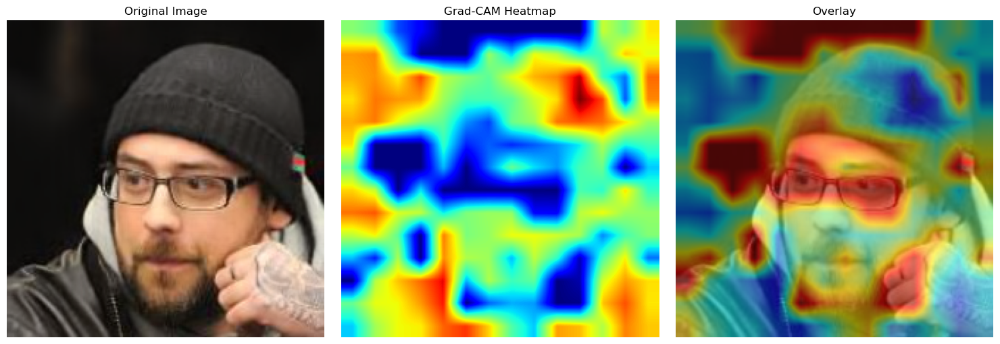

array([[[0.25686276, 0.5235294 , 0.29215688],
        [0.25686276, 0.5235294 , 0.29215688],
        [0.25686276, 0.5235294 , 0.29215688],
        ...,
        [0.02941176, 0.45882353, 0.5254902 ],
        [0.02941176, 0.45882353, 0.527451  ],
        [0.03137255, 0.46078432, 0.527451  ]],

       [[0.25686276, 0.5235294 , 0.29215688],
        [0.25686276, 0.5235294 , 0.29215688],
        [0.25686276, 0.5235294 , 0.29215688],
        ...,
        [0.02941176, 0.45882353, 0.5254902 ],
        [0.02941176, 0.45882353, 0.5254902 ],
        [0.03137255, 0.46078432, 0.527451  ]],

       [[0.25686276, 0.5235294 , 0.29215688],
        [0.25686276, 0.5235294 , 0.29215688],
        [0.25686276, 0.5235294 , 0.29215688],
        ...,
        [0.02941176, 0.45882353, 0.5254902 ],
        [0.02941176, 0.45882353, 0.527451  ],
        [0.03137255, 0.46078432, 0.527451  ]],

       ...,

       [[0.6745098 , 0.56078434, 0.16078432],
        [0.6862745 , 0.57058823, 0.17058824],
        [0.6882353 , 0

In [13]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from transformers import ViTImageProcessor, ViTForImageClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
from PIL import Image
import os
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms

# Create a directory for saving models
save_dir = "D:/thesis/article 2/ViT/saved_models_ff/"
os.makedirs(save_dir, exist_ok=True)

# Load ViT model and processor
feature_extractor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")

# Modify the classifier head for binary classification
model.classifier = nn.Linear(model.config.hidden_size, 2)  # 2 classes for binary classification

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Custom Dataset Class
class ImageDataset(Dataset):
    def __init__(self, images, labels, processor):
        self.images = images
        self.labels = labels
        self.processor = processor
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]

        if isinstance(image, np.ndarray):
            image = Image.fromarray(image)
        elif isinstance(image, str):
            image = Image.open(image).convert("RGB")

        image = image.resize((224, 224))  # Resize to ViT input size
        inputs = self.processor(image, return_tensors="pt")

        return {key: val.squeeze(0) for key, val in inputs.items()}, torch.tensor(label)

# Evaluation function
def evaluate(model, loader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for batch in loader:
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}  # Ensure float32
            labels = labels.to(device).long()  # Ensure labels are long

            outputs = model(**inputs).logits
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

    return correct / total

# Training function with checkpointing
def train_model(model, train_loader, val_loader, epochs=5):
    # Define optimizer and criterion
    optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)
    criterion = nn.CrossEntropyLoss()
    
    # Initialize variables for tracking best model
    best_val_acc = 0.0
    best_epoch = 0
    
    # Training loop
    for epoch in range(epochs):
        model.train()
        total_loss = 0
        correct = 0
        total = 0

        for batch_idx, batch in enumerate(train_loader):
            inputs, labels = batch
            inputs = {key: val.to(device).float() for key, val in inputs.items()}
            labels = labels.to(device).long()
            
            optimizer.zero_grad()
            outputs = model(**inputs).logits
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)
            
            # Print progress
            if batch_idx % 50 == 0:
                print(f'Epoch: {epoch+1}/{epochs} | Batch: {batch_idx}/{len(train_loader)} | Loss: {loss.item():.4f}')

        # Calculate metrics
        train_acc = correct / total
        val_acc = evaluate(model, val_loader)
        
        print(f"Epoch {epoch+1}/{epochs} | Loss: {total_loss/len(train_loader):.4f} | Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")
        
        # Save checkpoint if this is the best model so far
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_epoch = epoch + 1
            
            # Save model and optimizer state
            checkpoint = {
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }
            
            checkpoint_path = os.path.join(save_dir, f'vit_best_model_epoch_{epoch+1}.pth')
            torch.save(checkpoint, checkpoint_path)
            print(f"Saved best model with validation accuracy: {val_acc:.4f}")
        
        # Save a checkpoint every few epochs
        if (epoch + 1) % 2 == 0:  # Save every 2 epochs
            checkpoint_path = os.path.join(save_dir, f'vit_checkpoint_epoch_{epoch+1}.pth')
            torch.save({
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
                'train_acc': train_acc,
                'loss': total_loss/len(train_loader)
            }, checkpoint_path)
    
    # Save the final model
    final_model_path = os.path.join(save_dir, 'vit_final_model.pth')
    torch.save(model.state_dict(), final_model_path)
    
    # Also save the complete model for easier loading
    complete_model_path = os.path.join(save_dir, 'vit_complete_model.pth')
    torch.save({
        'model_state_dict': model.state_dict(),
        'feature_extractor': feature_extractor,
        'model_config': model.config
    }, complete_model_path)
    
    print(f"Training completed. Best validation accuracy: {best_val_acc:.4f} at epoch {best_epoch}")
    return best_val_acc

# Function to load a saved model
def load_saved_model(model_path, device):
    checkpoint = torch.load(model_path, map_location=device)
    
    # Create a new model instance
    model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k")
    model.classifier = nn.Linear(model.config.hidden_size, 2)
    
    # Load the saved weights
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()
    
    return model

# Fixed Grad-CAM implementation for ViT
class ViTGradCAM:
    def __init__(self, model, feature_extractor):
        self.model = model
        self.feature_extractor = feature_extractor
        self.gradients = None
        self.activations = None
        self.model.eval()
        self._register_hooks()
    
    def _register_hooks(self):
        # Register hooks to get gradients and activations from the last attention layer
        target_layer = self.model.vit.encoder.layer[-1].attention.attention.value
        
        def forward_hook(module, input, output):
            self.activations = output
        
        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0]
        
        self.forward_handle = target_layer.register_forward_hook(forward_hook)
        self.backward_handle = target_layer.register_backward_hook(backward_hook)
    
    def __call__(self, input_tensor, target_class=None):
        # Forward pass
        outputs = self.model(**input_tensor)
        
        if target_class is None:
            target_class = outputs.logits.argmax(dim=1).item()
        
        # Backward pass
        self.model.zero_grad()
        loss = outputs.logits[0, target_class]
        loss.backward()
        
        # Get gradients and activations
        gradients = self.gradients.detach().cpu().numpy()[0]  # [num_patches+1, hidden_size]
        activations = self.activations.detach().cpu().numpy()[0]  # [num_patches+1, hidden_size]
        
        # Remove CLS token (first token)
        gradients = gradients[1:]  # [num_patches, hidden_size]
        activations = activations[1:]  # [num_patches, hidden_size]
        
        # Global average pooling of gradients
        weights = np.mean(gradients, axis=0)  # Average across patches
        
        # Weight the activations
        cam = np.zeros(activations.shape[0], dtype=np.float32)  # num_patches
        for i in range(weights.shape[0]):  # Iterate over hidden_size
            cam += weights[i] * activations[:, i]  # Weight each patch
        
        # Apply ReLU
        cam = np.maximum(cam, 0)
        
        # Normalize
        if np.max(cam) > 0:
            cam = cam / np.max(cam)
        
        # Reshape to patch grid (for ViT-base-patch16-224, this is 14x14)
        num_patches = int(np.sqrt(cam.shape[0]))
        cam = cam.reshape(num_patches, num_patches)
        
        # Resize to match input image size
        cam = cv2.resize(cam, (224, 224))
        
        return cam
    
    def remove_hooks(self):
        self.forward_handle.remove()
        self.backward_handle.remove()
# Function to visualize Grad-CAM
def visualize_gradcam(image_path, model, feature_extractor, target_class=None):
    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    original_image = image.copy()
    image = image.resize((224, 224))
    
    # Preprocess for ViT
    inputs = feature_extractor(image, return_tensors="pt")
    inputs = {key: val.to(device) for key, val in inputs.items()}
    
    # Create Grad-CAM
    gradcam = ViTGradCAM(model, feature_extractor)
    cam = gradcam(inputs, target_class)
    gradcam.remove_hooks()
    
    # Convert to heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    
    # Convert image to numpy array
    image_np = np.array(image) / 255.0
    
    # Blend image and heatmap
    cam_image = heatmap + np.float32(image_np)
    cam_image = cam_image / np.max(cam_image)
    
    # Display results
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 3, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.imshow(cam, cmap='jet')
    plt.title("Grad-CAM Heatmap")
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.imshow(cam_image)
    plt.title("Overlay")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return cam_image




best_model_path = os.path.join(save_dir, 'vit_best_model_epoch_7.pth')  # Replace X with the best epoch
#best_model_path = os.path.join(save_dir, 'vit_checkpoint_epoch_10.pth')  # Replace X with the best epoch
loaded_model = load_saved_model(best_model_path, device)
# Apply Grad-CAM to a sample image

sample_image_path = "D:/thesis/dataset/deepfake dataset/1-GDWCT/62.png"
visualize_gradcam(sample_image_path, loaded_model, feature_extractor)

VIT 16
Dataset: DFC
GDWCT


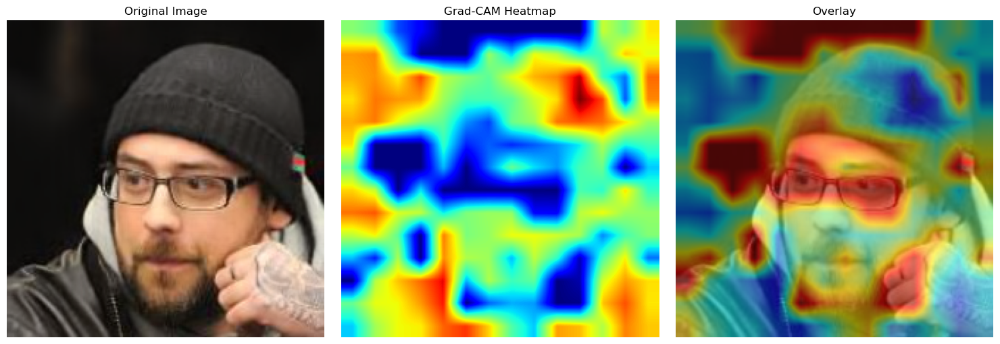

attaGan


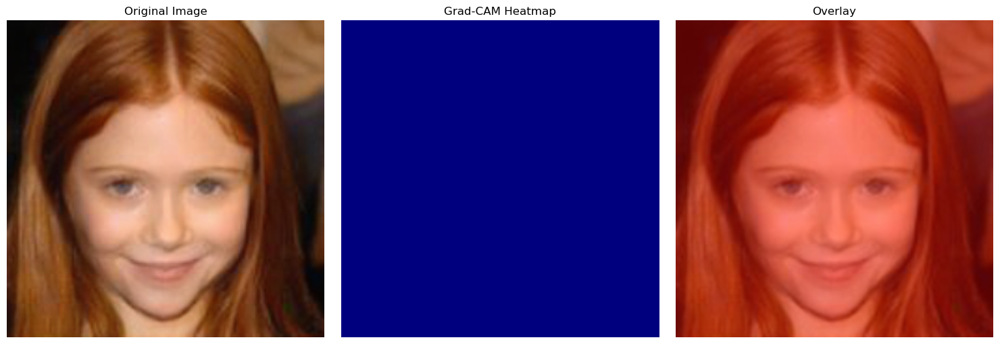

stargan


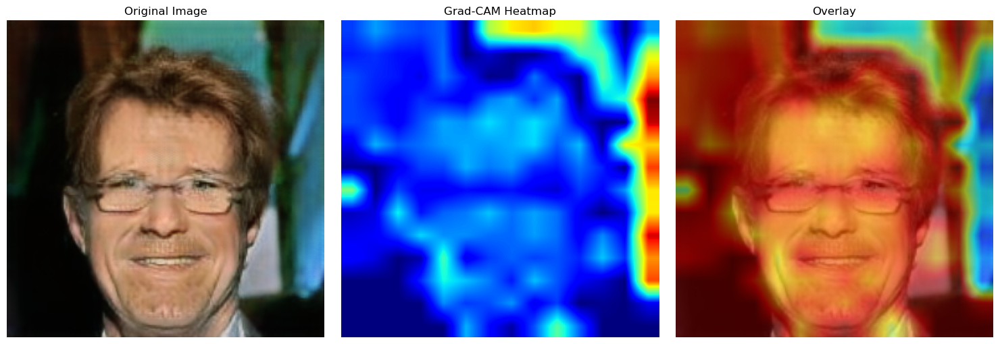

stylegan 2


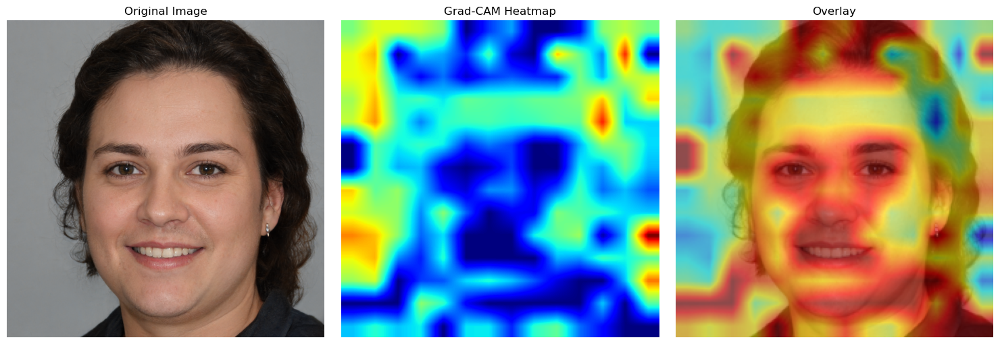

stylegan 1


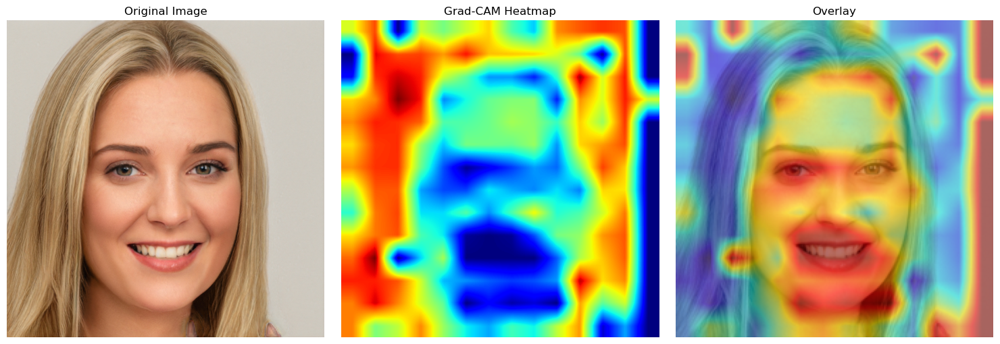

Dataset: Celeb


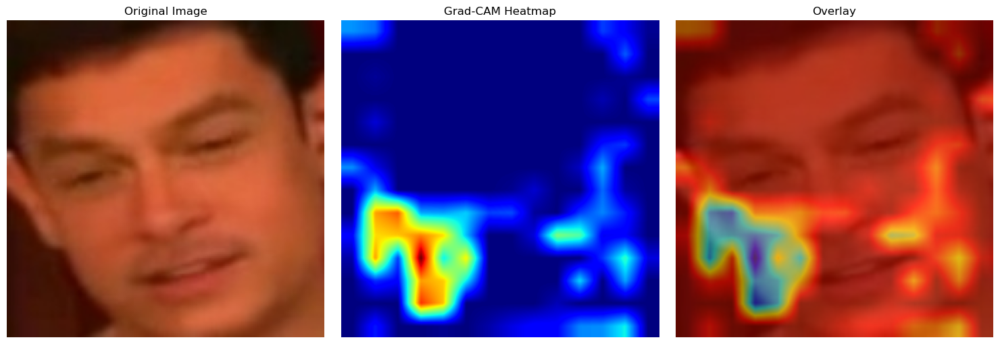

Dataset: FF++
DFD


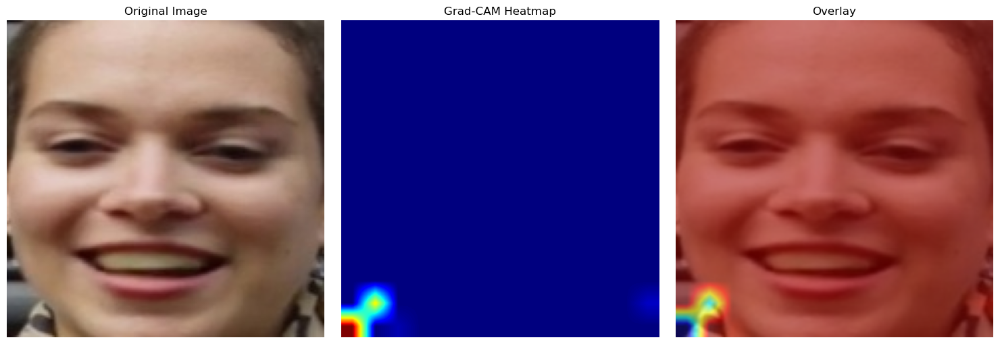

DF


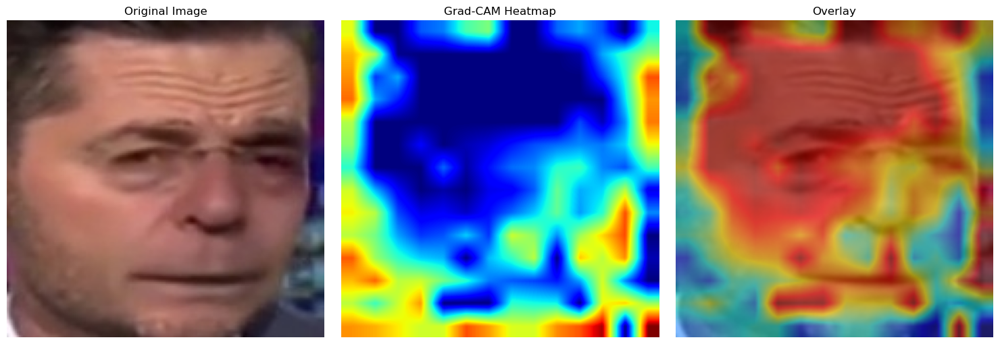

Faceshifter


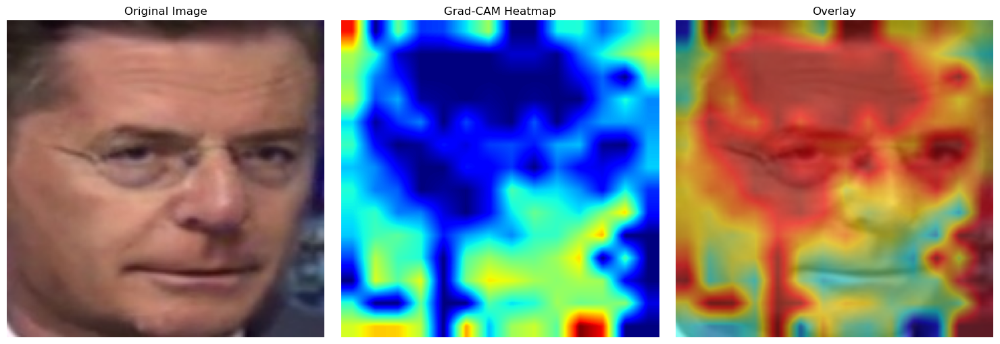

Faceswap


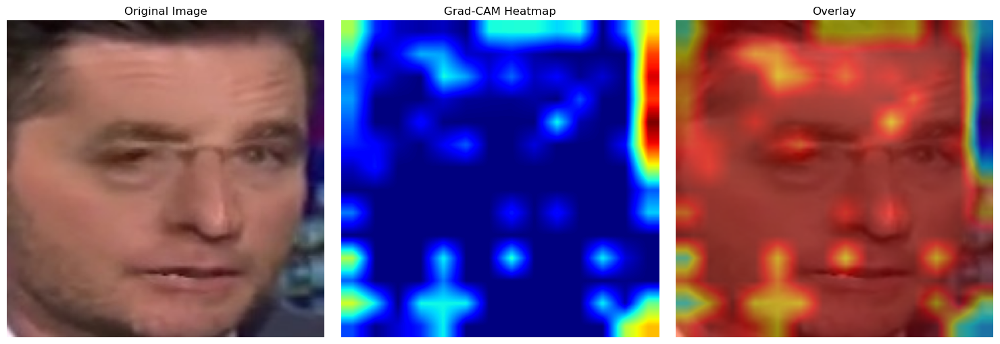

F2f


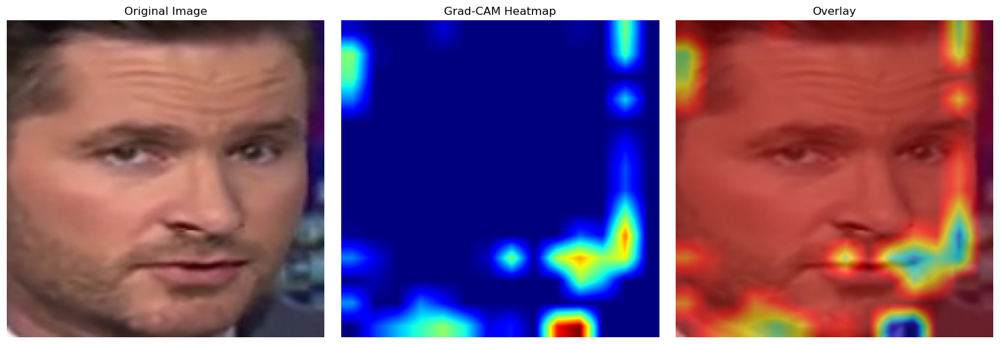

NT


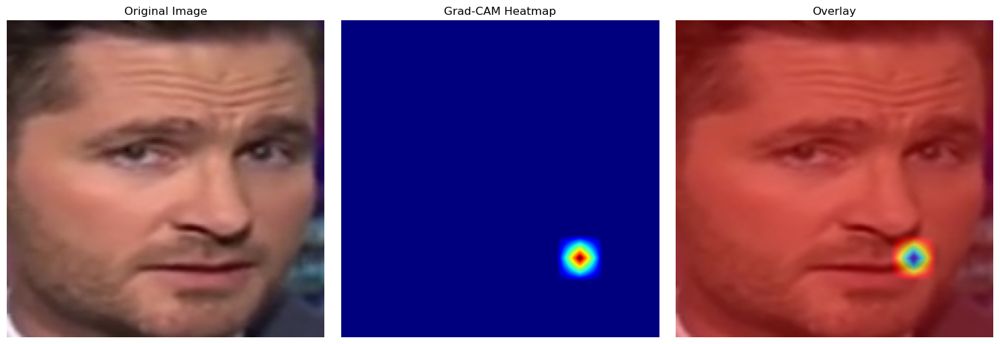

array([[[0.38740918, 0.04842615, 0.05326876],
        [0.38740918, 0.04842615, 0.05326876],
        [0.38740918, 0.04842615, 0.05326876],
        ...,
        [0.41888618, 0.05811138, 0.15496369],
        [0.41404358, 0.05084746, 0.15738499],
        [0.41162226, 0.04842615, 0.1598063 ]],

       [[0.3898305 , 0.05084746, 0.05569007],
        [0.3898305 , 0.05084746, 0.05569007],
        [0.3898305 , 0.05084746, 0.05326876],
        ...,
        [0.4213075 , 0.06053269, 0.15496369],
        [0.41404358, 0.05084746, 0.15496369],
        [0.41162226, 0.04842615, 0.15738499]],

       [[0.39225182, 0.05326876, 0.05811138],
        [0.39225182, 0.05326876, 0.05811138],
        [0.3946731 , 0.05569007, 0.05569007],
        ...,
        [0.4213075 , 0.0653753 , 0.15254237],
        [0.41404358, 0.05326876, 0.15012106],
        [0.40920097, 0.05084746, 0.15254237]],

       ...,

       [[0.8523002 , 0.5230024 , 0.5520581 ],
        [0.87167066, 0.53753024, 0.56658596],
        [0.89588374, 0

In [14]:
# Load and process image
print("VIT 16")
print("Dataset: DFC")
print("GDWCT")
image_path = "D:/thesis/dataset/deepfake dataset/1-GDWCT/62.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("attaGan")
image_path = "D:/thesis/dataset/deepfake dataset/1-ATTGAN/37.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stargan")
image_path = "D:/thesis/dataset/deepfake dataset/1-StarGAN/image_200.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stylegan 2")
image_path = "D:/thesis/dataset/deepfake dataset/1-STYLEGAN2/000200.png"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("stylegan 1")
image_path = "D:/thesis/dataset/deepfake dataset/1-STYLEGAN/000201.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
########################################################################################################
print("Dataset: Celeb")
image_path = "D:\\thesis\\dataset\\Celeb-DF-v2\\id00p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Dataset: FF++")
print("DFD")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\dfd_001p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("DF")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\df_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Faceshifter")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\faceshifter_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("Faceswap")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\faceswap_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("F2f")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\f2f_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)
#######################################################################################################
print("NT")
image_path = "D:\\thesis\\dataset\\ff++\\manipulated_sequences\\nt_004_982p.jpg"
visualize_gradcam(image_path, loaded_model, feature_extractor)

